In [6]:
import os
import pickle
import re
import glob
import sys
import random
import itertools
import numpy as np
import pandas as pd
import matplotlib.ticker as ticker
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.model_selection import LeaveOneGroupOut, KFold, GroupKFold
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.metrics import confusion_matrix, classification_report, balanced_accuracy_score,ConfusionMatrixDisplay
from collections import Counter
from itertools import combinations
from modeltransfer import emsc
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
from brokenaxes import brokenaxes
from pltspectra import plot_individual_spectra
from matplotlib.colors import ListedColormap
from pltspectra import plot_stacked_spectra, plot_stacked_spectra2, plot_individual_spectra

In [2]:
### load data 
data_path = '/Users/laying/Desktop/P1_cancer_differentiation/Results'
input_file = os.path.join(data_path, 'combined_df_filter.pkl')
with open(input_file, 'rb') as f:
    combined_df_filter = pickle.load(f)
input_file2 = os.path.join(data_path, 'processed_data_dict.pkl')
with open(input_file2, 'rb') as f:
    processed_data_dict = pickle.load(f)

In [3]:
combined_df_filter

,group,patient,cells,2998.56365,2996.63531,2994.70698,2992.77864,2990.8503,2988.92197,2986.99363,...,1016.23347,1014.30513,1012.3768,1010.44846,1008.52012,1006.59179,1004.66345,1002.73511,1000.80678,patient_id
256,2.0,Patient#46,6,0.000071,0.002322,0.00443,0.006326,0.007963,0.009316,0.010374,...,0.015993,0.017785,0.018373,0.017212,0.014119,0.009441,0.004225,0.000391,0.000895,46
257,2.0,Patient#46,6,-0.001008,0.003546,0.005772,0.006599,0.006736,0.006699,0.00683,...,0.028785,0.02507,0.020759,0.016264,0.011972,0.008185,0.005067,0.002581,0.000434,46
258,2.0,Patient#46,6,-0.000635,0.001413,0.00483,0.008176,0.010655,0.011983,0.012271,...,0.019342,0.016998,0.014883,0.012888,0.010864,0.008648,0.00608,0.003027,-0.000594,46
259,2.0,Patient#46,6,-0.000745,0.003976,0.006079,0.006977,0.007606,0.008496,0.00985,...,0.018717,0.018375,0.017325,0.015409,0.012598,0.009042,0.005111,0.00145,-0.000982,46
260,2.0,Patient#46,6,-0.000743,0.005389,0.009726,0.01253,0.014081,0.01467,0.01459,...,0.022783,0.02131,0.019705,0.017617,0.014797,0.011177,0.006969,0.002744,-0.000477,46
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22267,2.0,Patient#59,1,0.000274,0.0001,0.000418,0.000927,0.00143,0.001818,0.002058,...,0.004167,0.004218,0.004165,0.00389,0.003323,0.002472,0.001458,0.000535,0.00013,59
22268,2.0,Patient#59,1,-0.000266,0.000946,0.001705,0.002092,0.002204,0.002144,0.002015,...,0.005283,0.004835,0.004332,0.003763,0.003115,0.002388,0.001594,0.000768,-0.000033,59
22269,2.0,Patient#59,1,0.000019,0.000266,0.000757,0.001327,0.001869,0.002327,0.002685,...,0.00566,0.004789,0.003929,0.003206,0.002689,0.002354,0.002053,0.001472,0.000098,59
22270,2.0,Patient#59,1,0.000502,0.000111,0.000646,0.001562,0.002491,0.00322,0.003663,...,0.005578,0.005242,0.004876,0.004474,0.004015,0.003447,0.002681,0.001577,-0.000067,59


In [4]:
processed_data_dict

{'WBCs':          patient  group 2998.56365_1 2996.63531_1 2994.70698_1 2992.77864_1  \
 0     Patient#13    1.0     0.000109    -0.000045     0.000136      0.00037   
 1     Patient#13    1.0    -0.000037     0.000254     0.000507     0.000631   
 2     Patient#13    1.0     0.000027     0.000202     0.000383     0.000463   
 3     Patient#13    1.0    -0.000036     0.000158     0.000398     0.000534   
 4     Patient#13    1.0     0.000033    -0.000022     0.000195     0.000431   
 ...          ...    ...          ...          ...          ...          ...   
 5371   Patient#8    2.0    -0.000496     0.001232     0.001833     0.001786   
 5372   Patient#8    2.0     0.000111     0.000671     0.001138     0.001456   
 5373   Patient#8    2.0    -0.000031     0.000483     0.000911     0.001162   
 5374   Patient#8    2.0    -0.000542     0.001235     0.001982     0.002068   
 5375   Patient#8    2.0     0.000055     0.000472     0.000999     0.001451   
 
      2990.8503_1 2988.92197_1

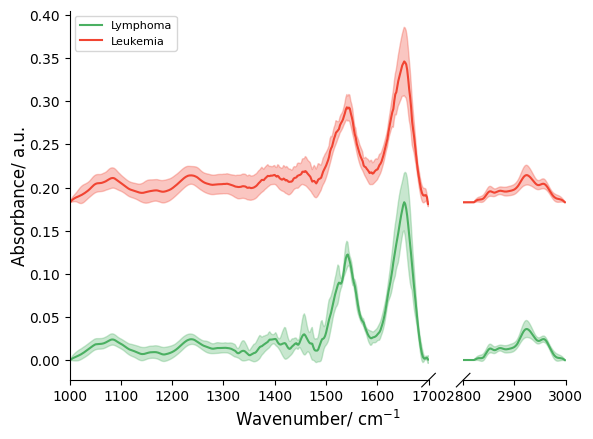

In [7]:
label_mapping = {1: 'Lymphoma', 2: 'Leukemia', }
group_colors = {1: plt.cm.Greens, 2: plt.cm.Reds}
spectra = combined_df_filter[combined_df_filter['cells']==1].iloc[:,:-1]
spectra1 = spectra.drop(columns=['cells'])
plot_stacked_spectra(spectra1, label_mapping, group_colors, n=1) ##plt spectra function

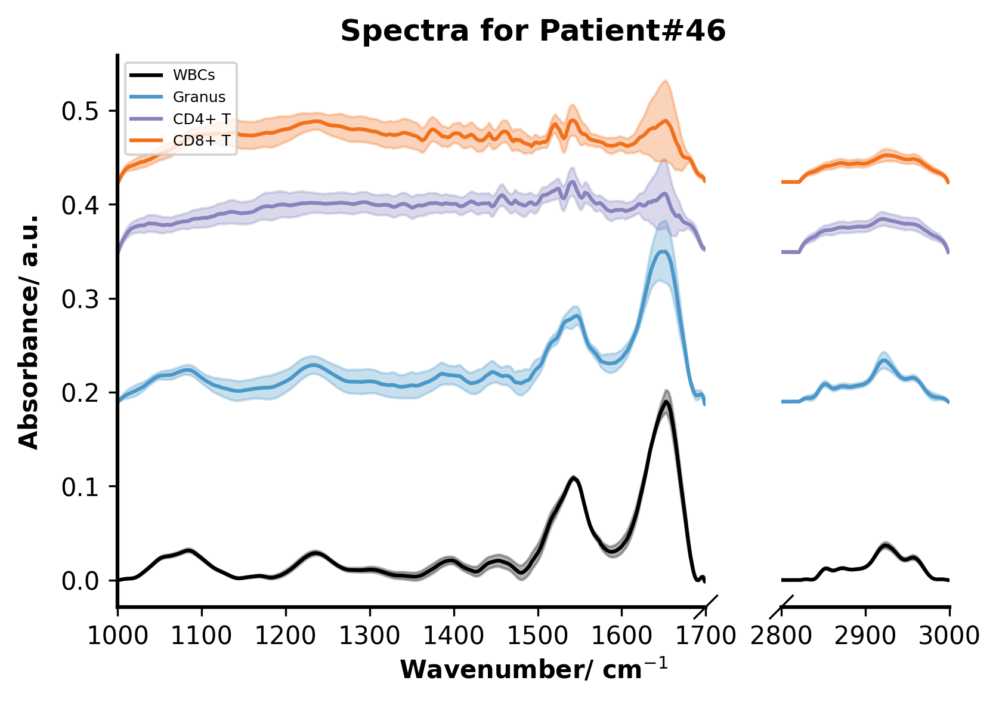

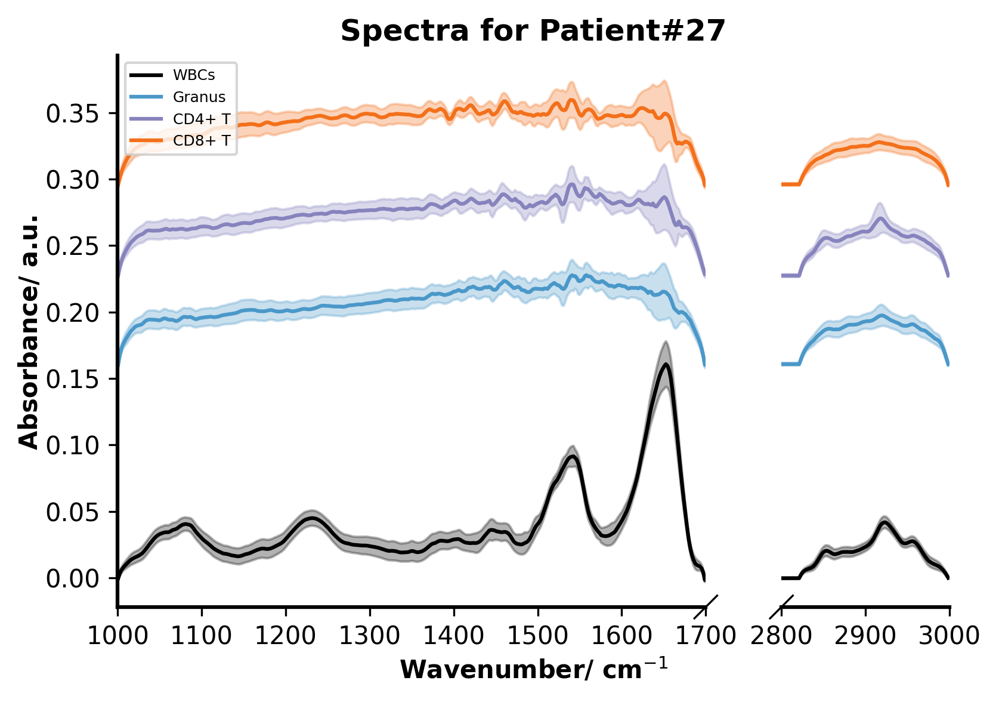

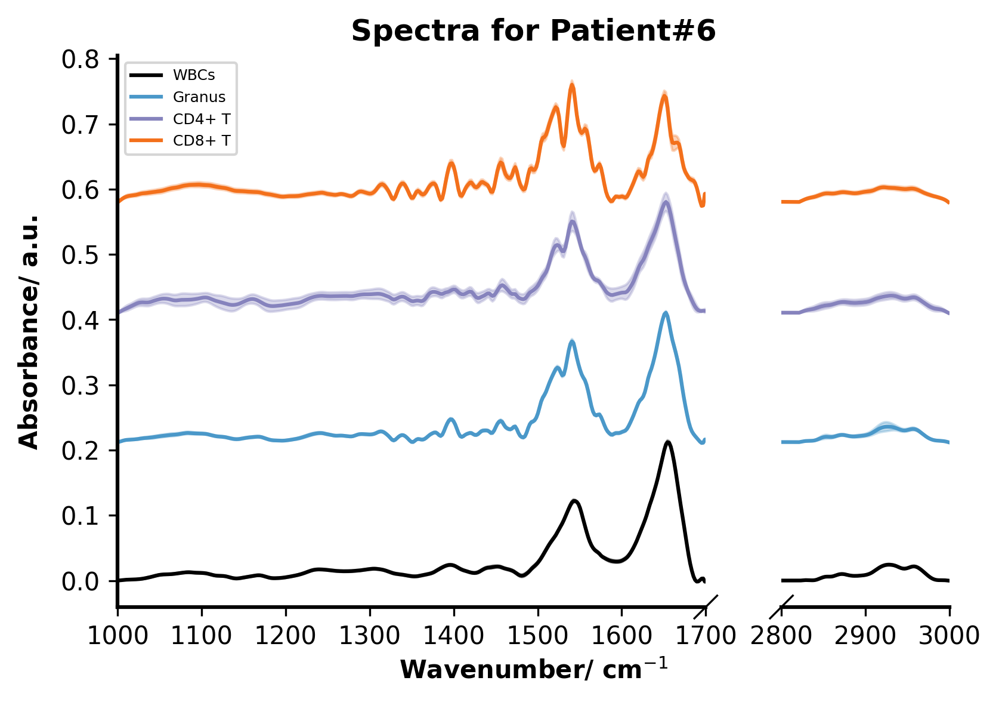

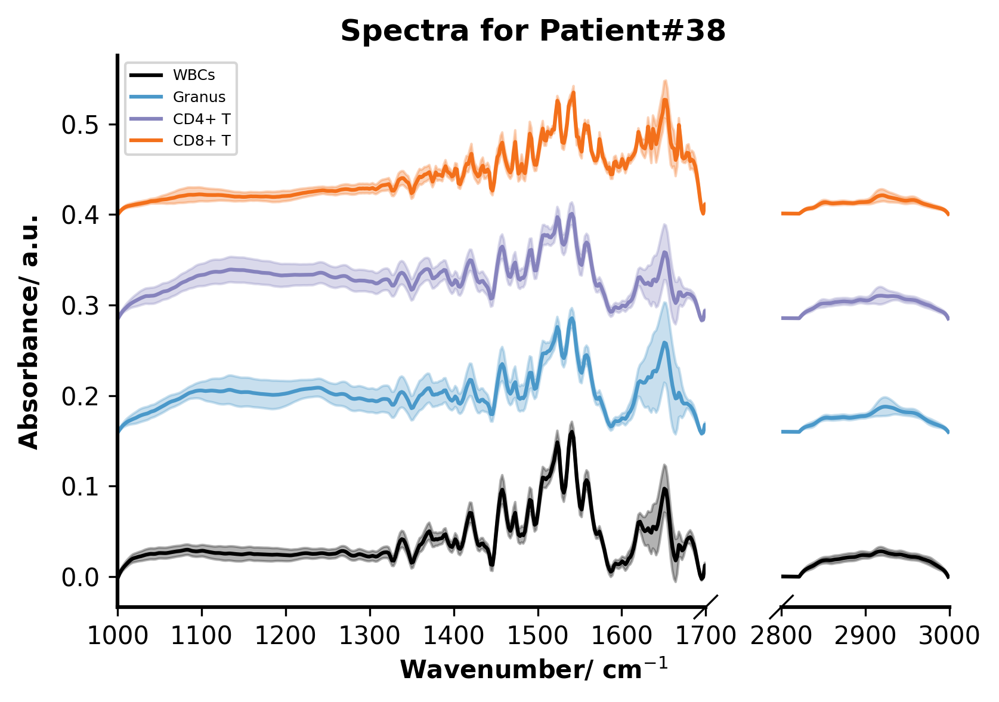

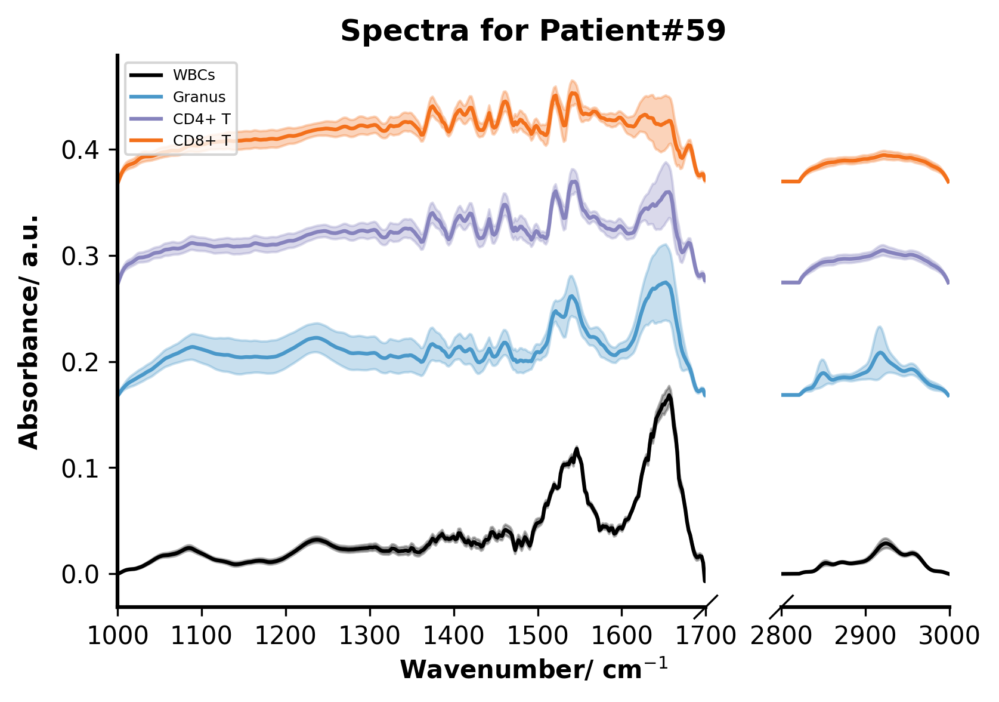

...

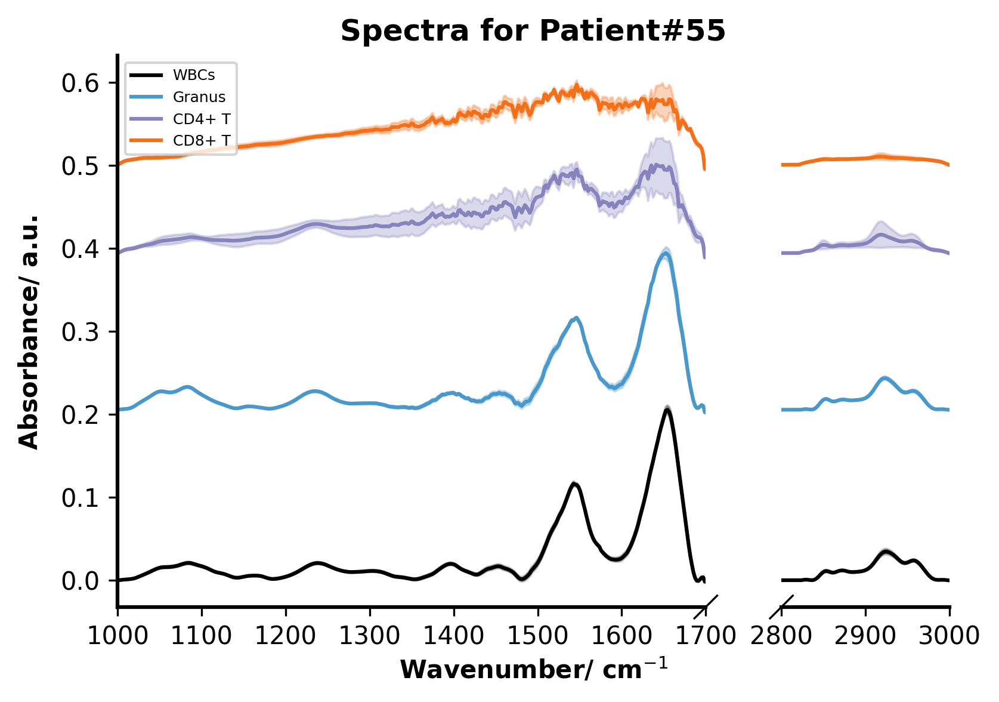

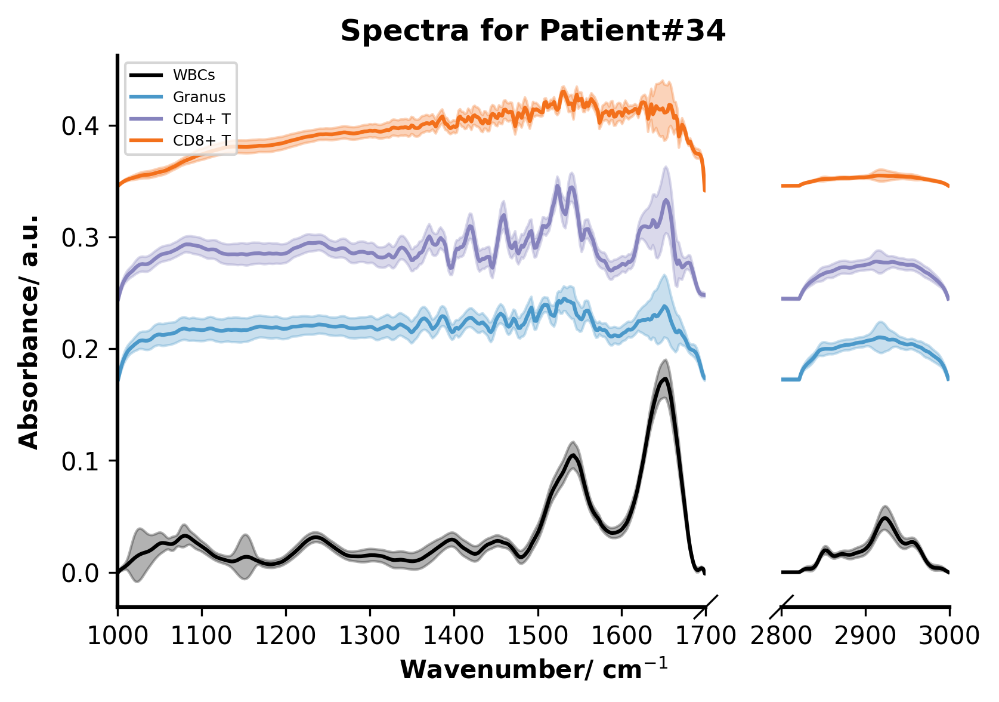

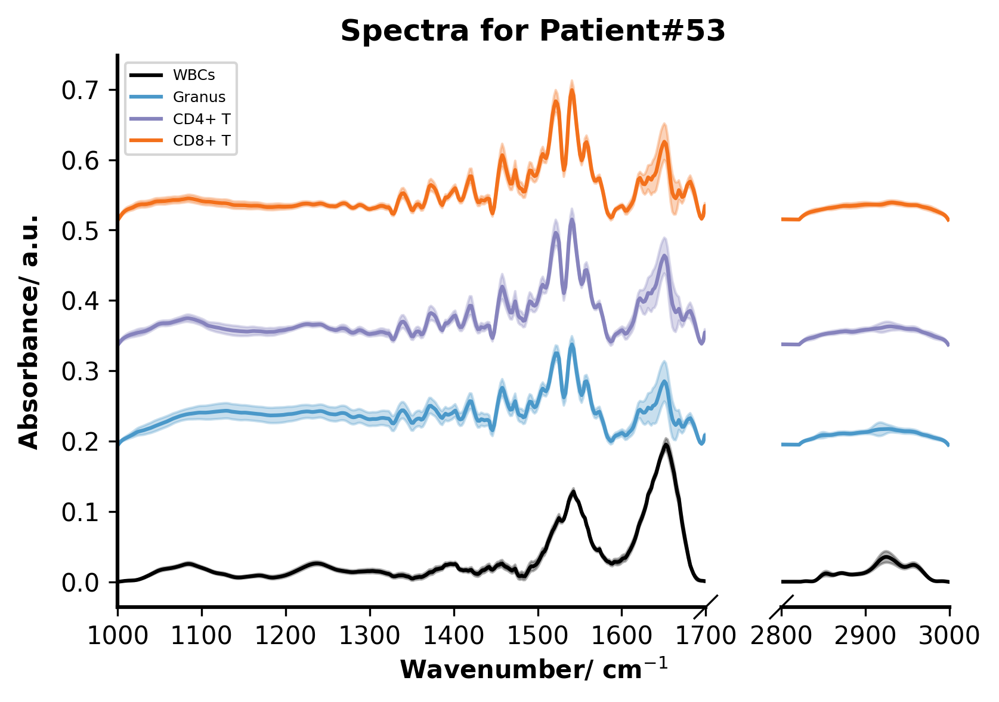

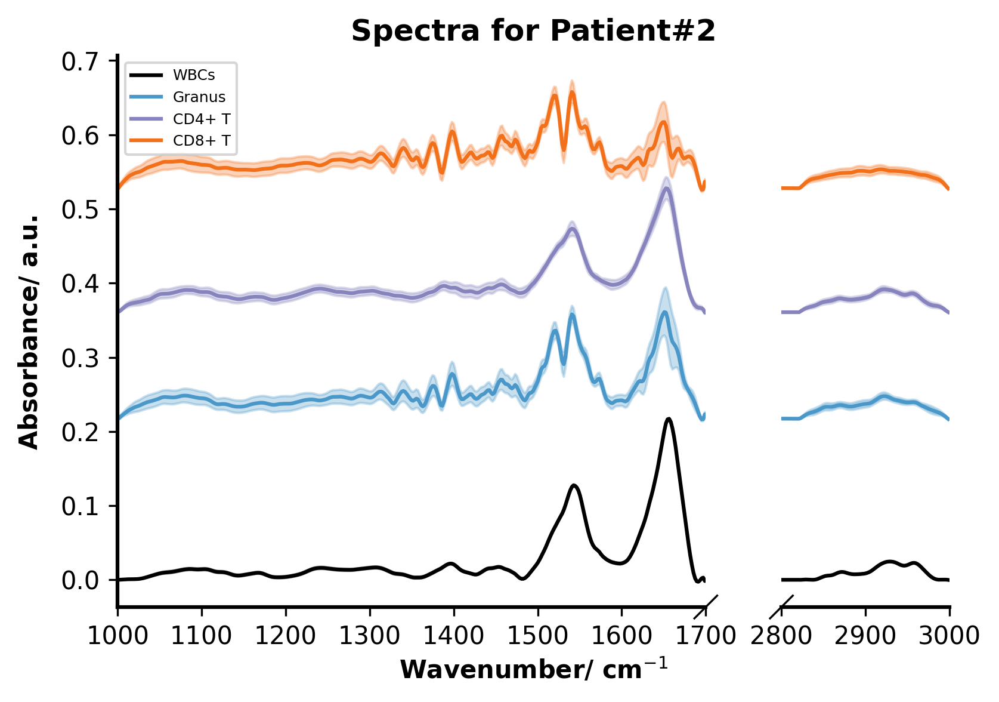

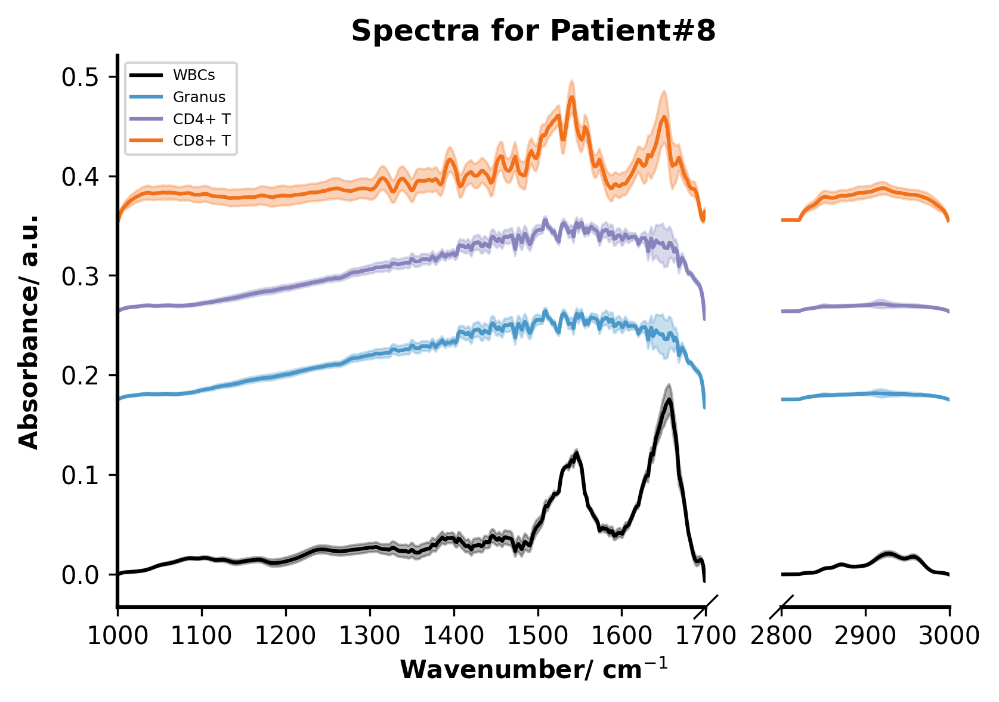

In [8]:
cell_check = combined_df_filter[combined_df_filter['group'].isin([1,2])].iloc[:,:-1]
d1 = cell_check['patient'].unique()
group_colors2 = {1:lambda _: 'black',2: plt.cm.Blues, 5:plt.cm.Purples, 6:plt.cm.Oranges}
cell_mapping={1: 'WBCs', 2: 'Granus',5:'CD4+ T',6:'CD8+ T'}
for patient in d1:
    patient_data = cell_check[cell_check['patient'] == patient]
    plot_stacked_spectra2(patient_data, cell_mapping, group_colors2,n=1, title=f'Spectra for {patient}',type_col='cells', figsize=(6, 4), dpi=300)

Number of components explaining 95% variance: 10


/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


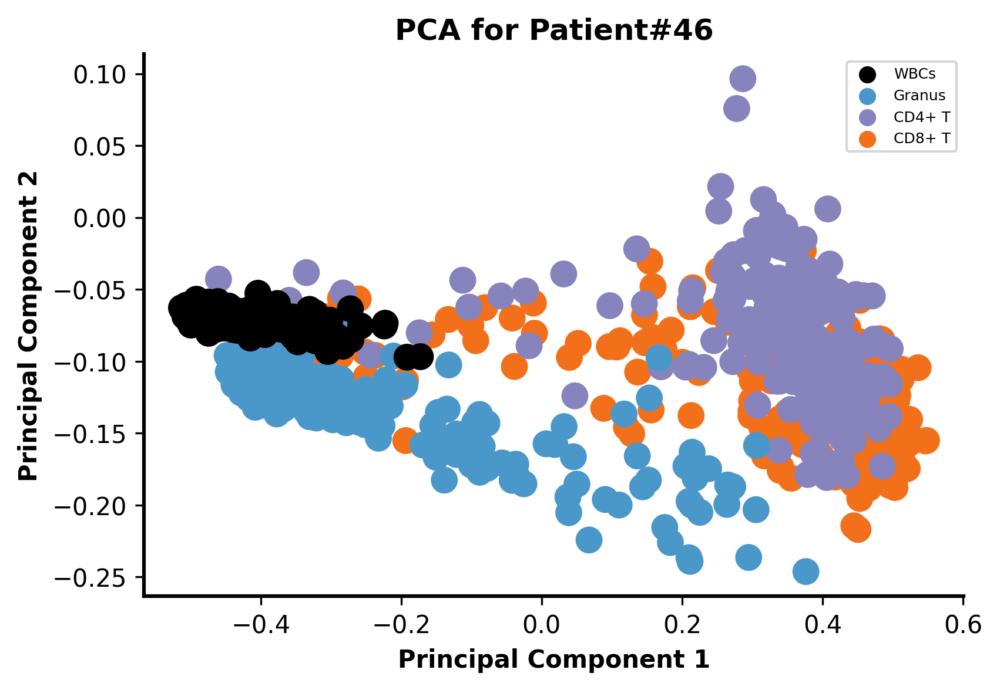

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


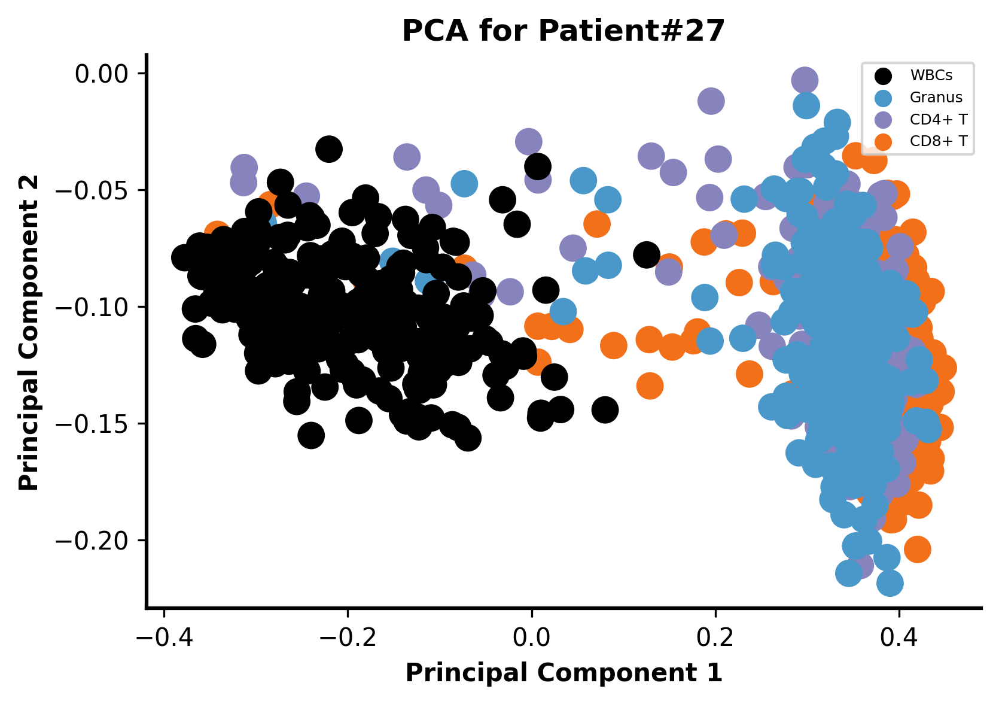

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


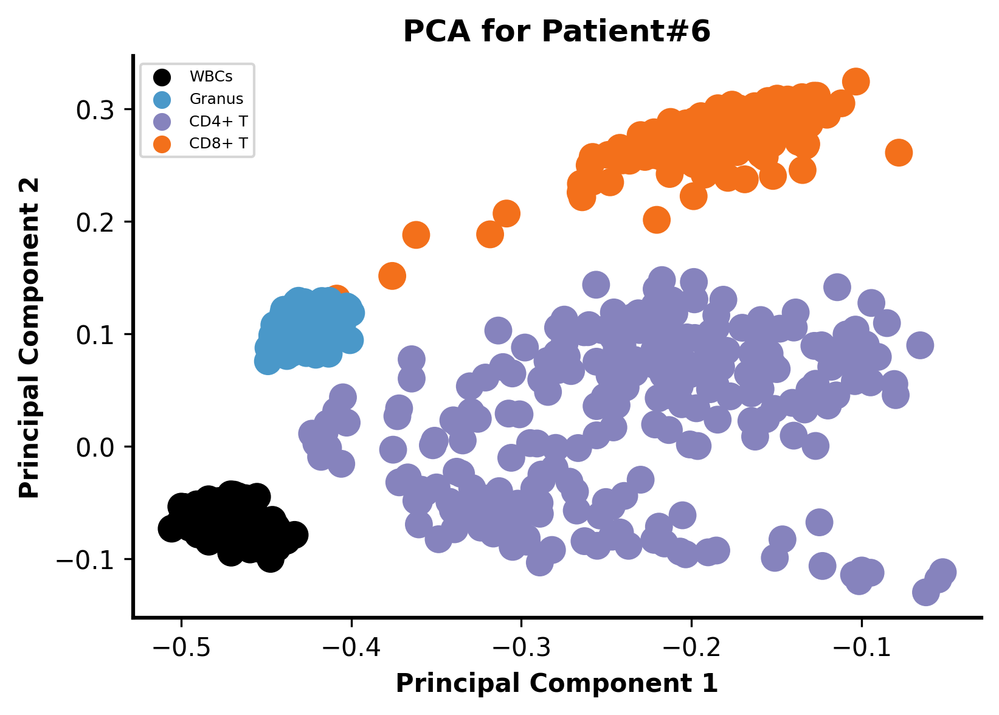

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


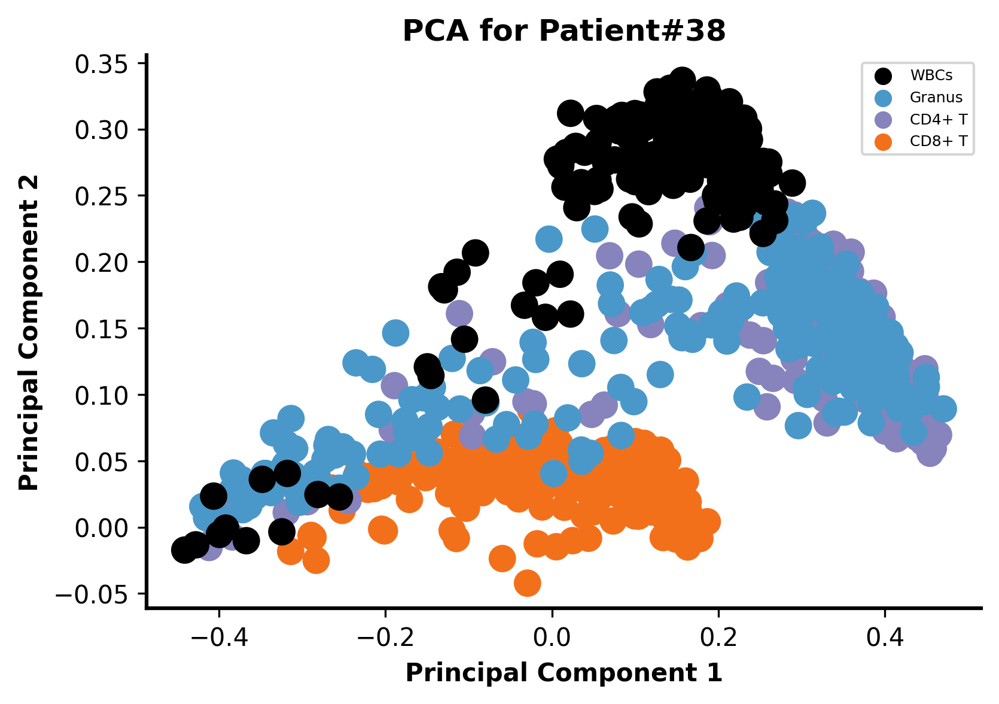

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


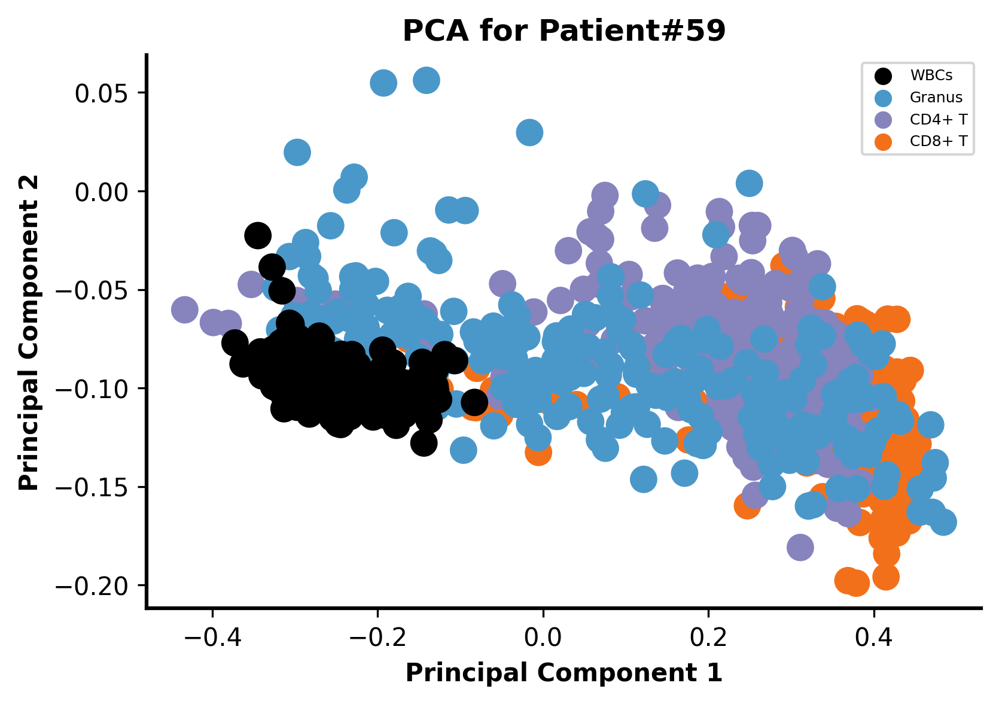

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


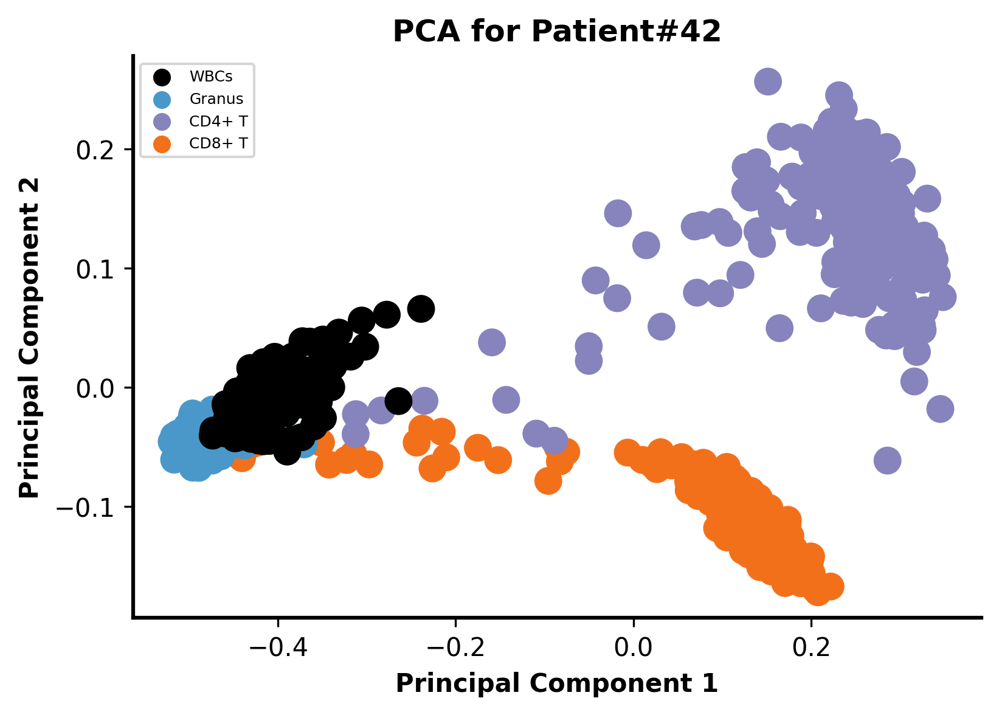

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


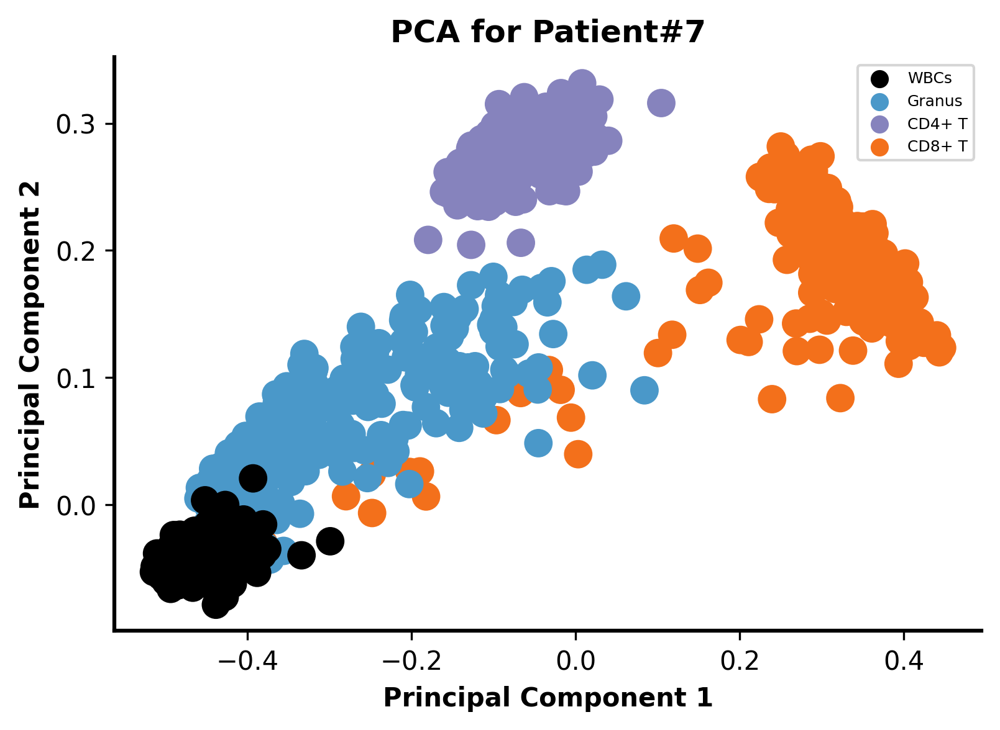

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


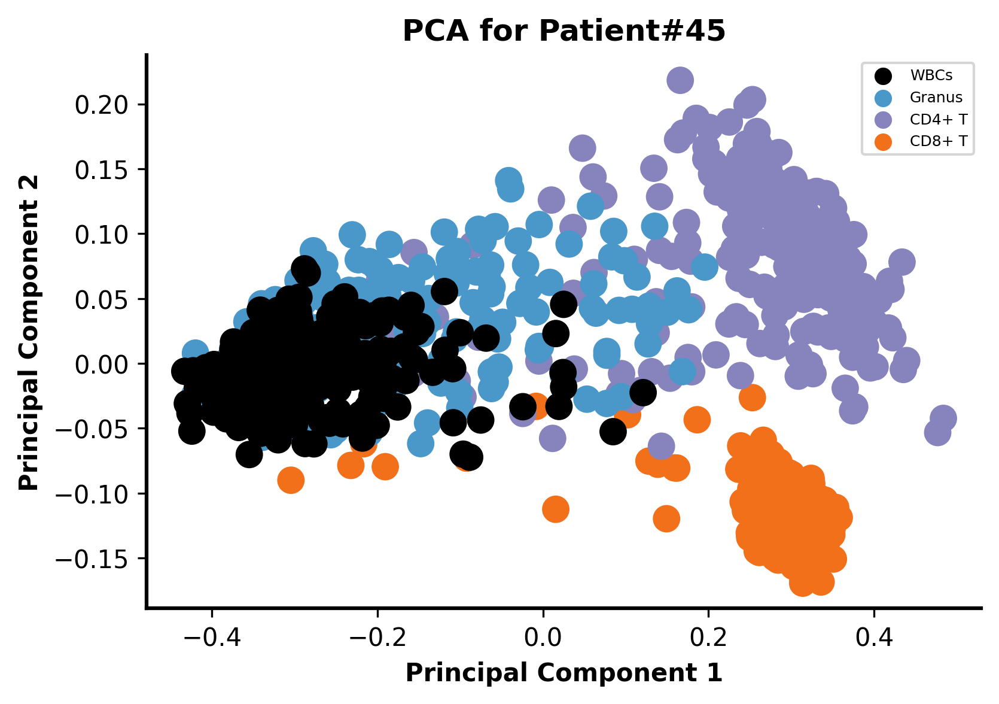

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


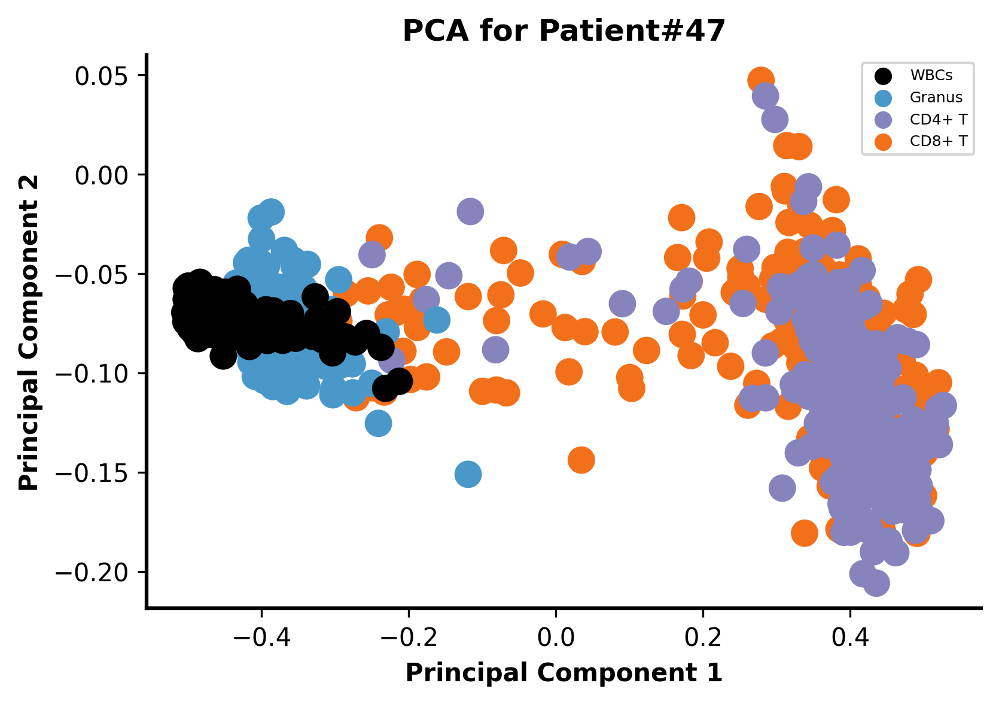

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


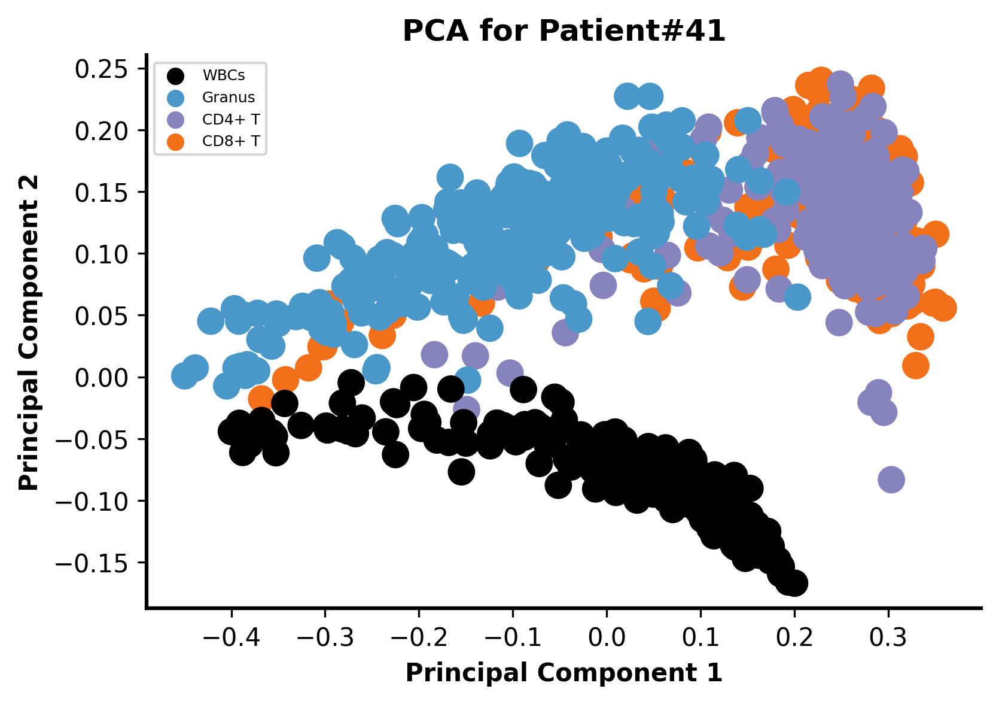

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


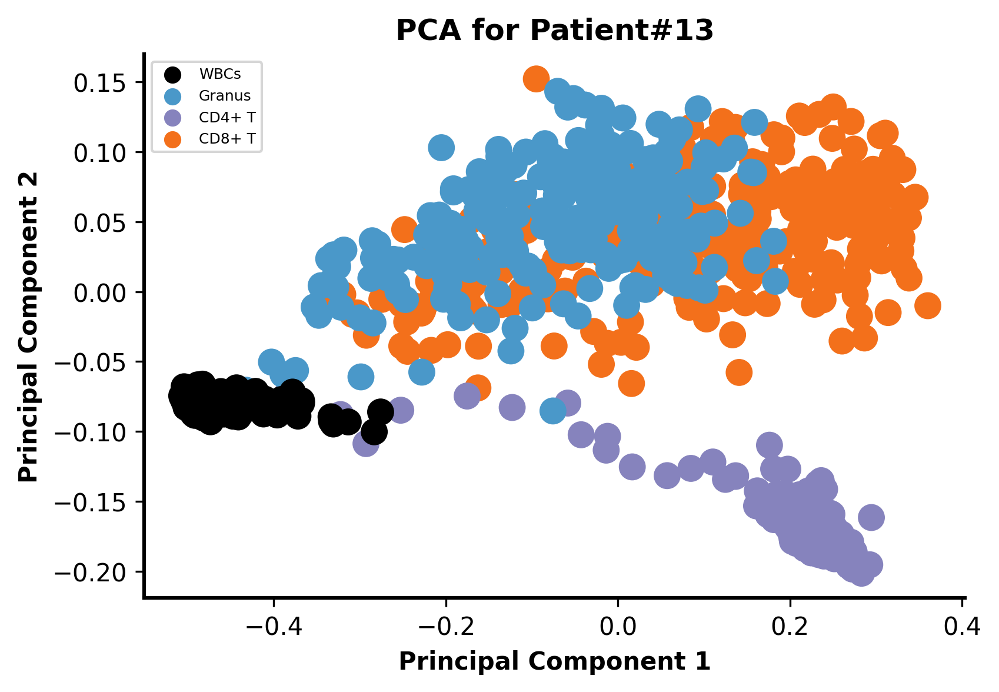

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


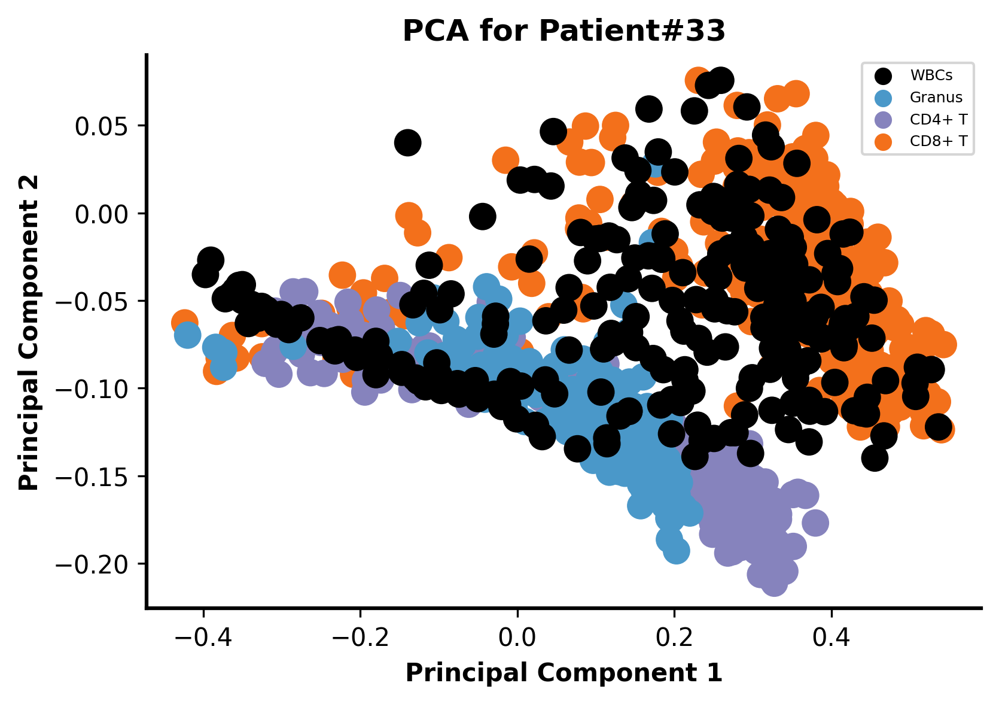

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


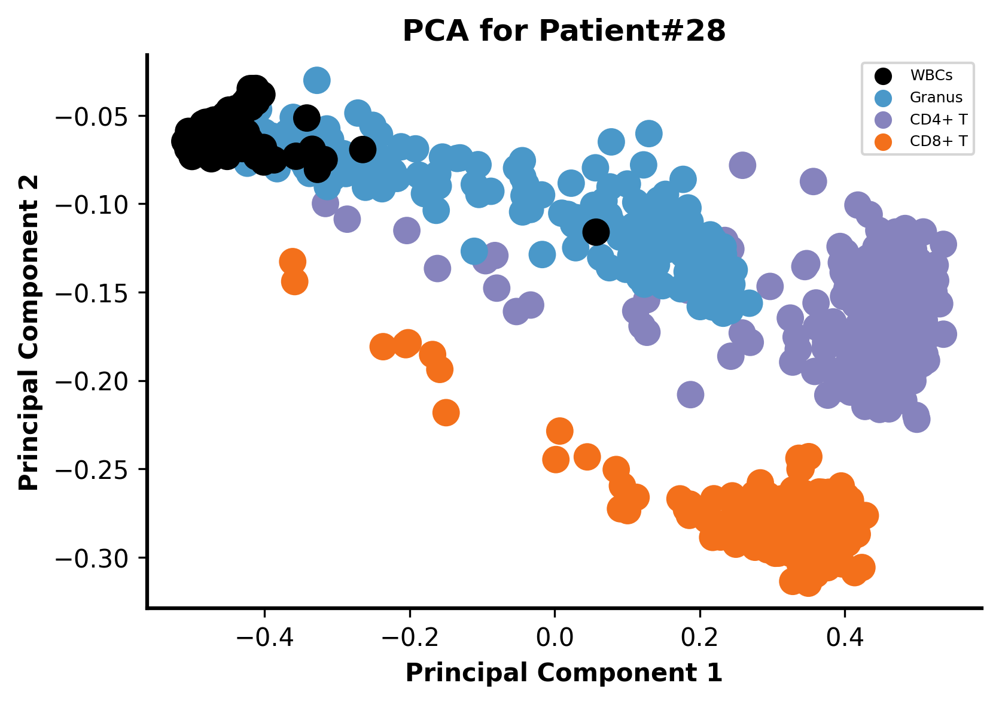

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


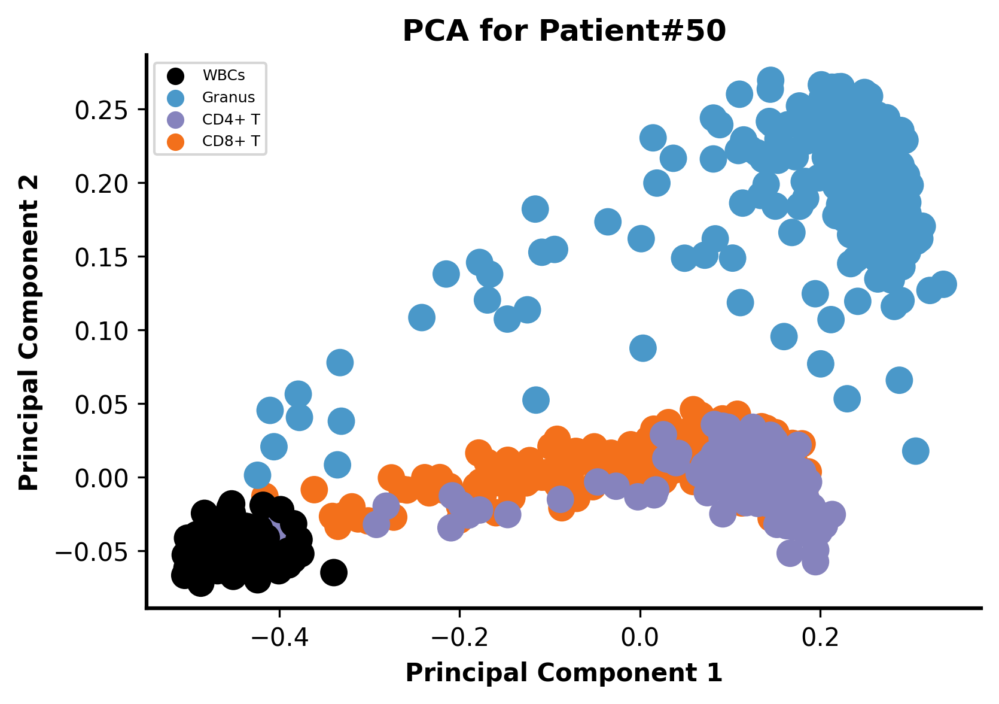

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


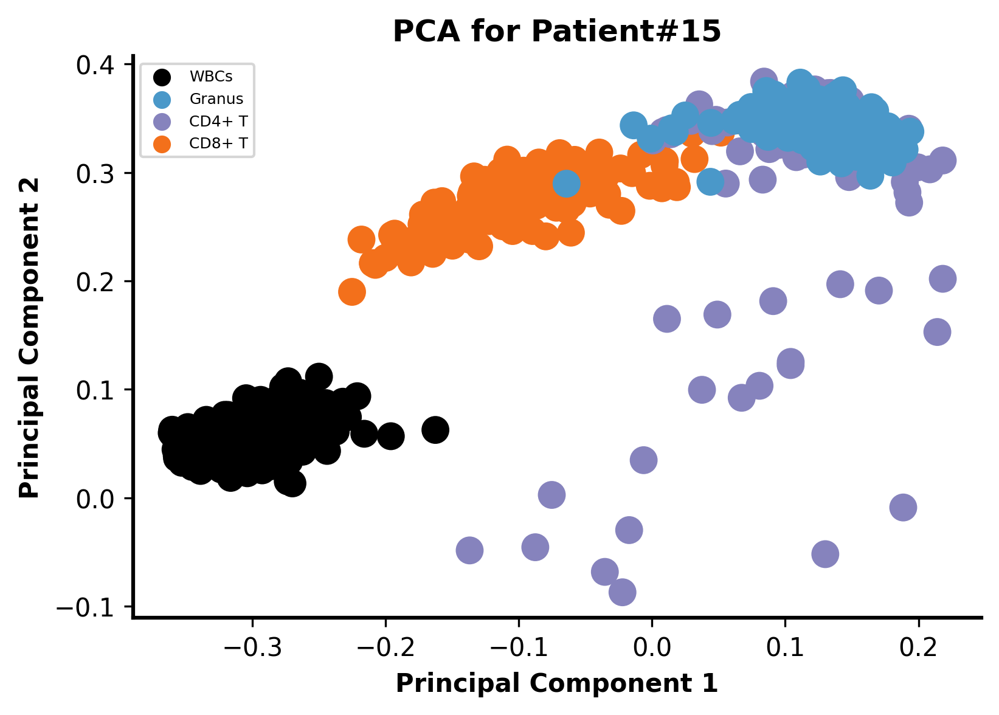

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


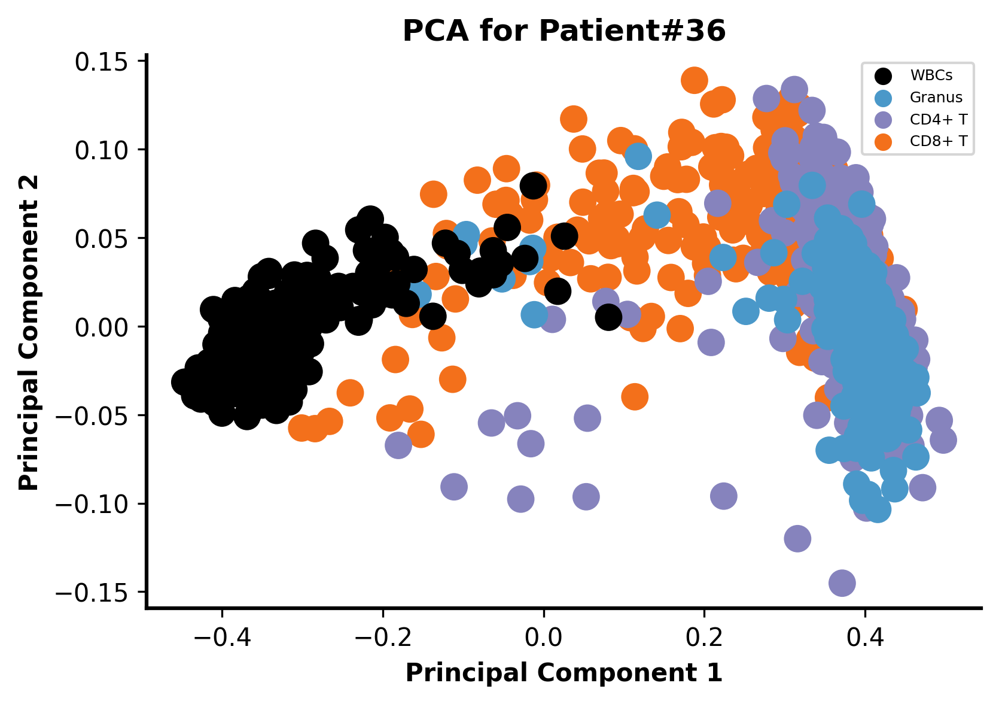

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


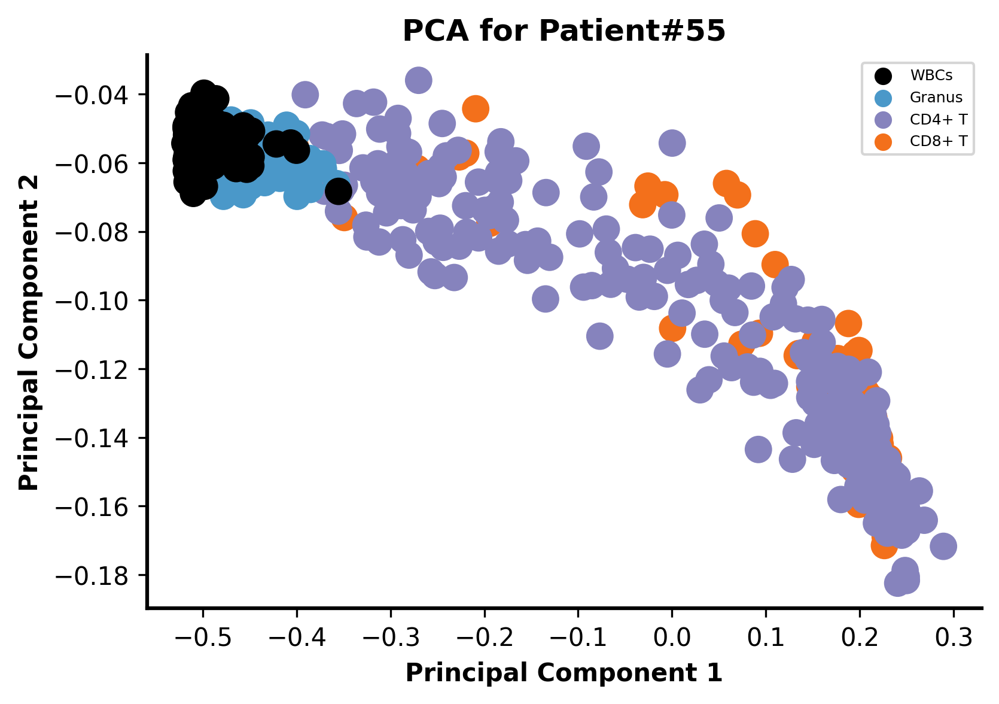

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


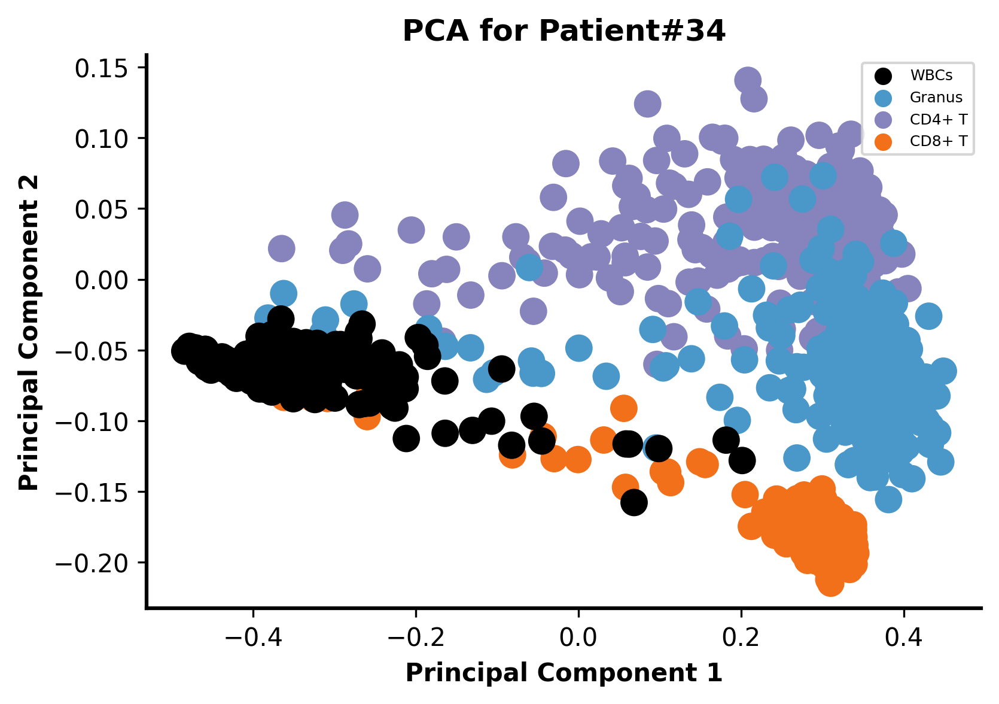

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


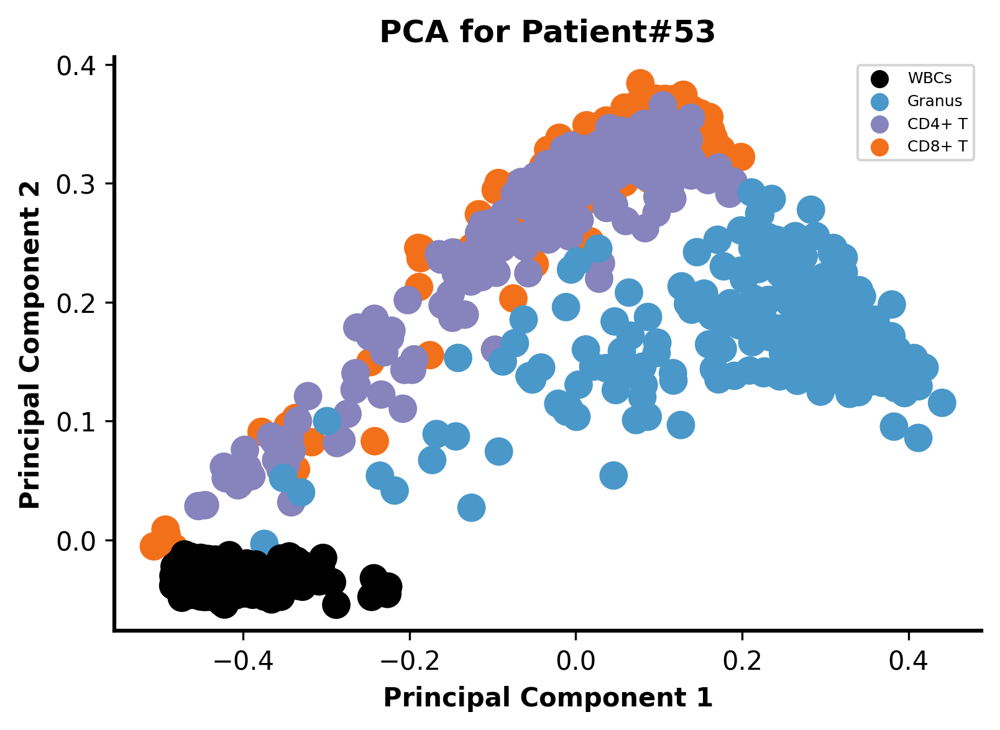

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


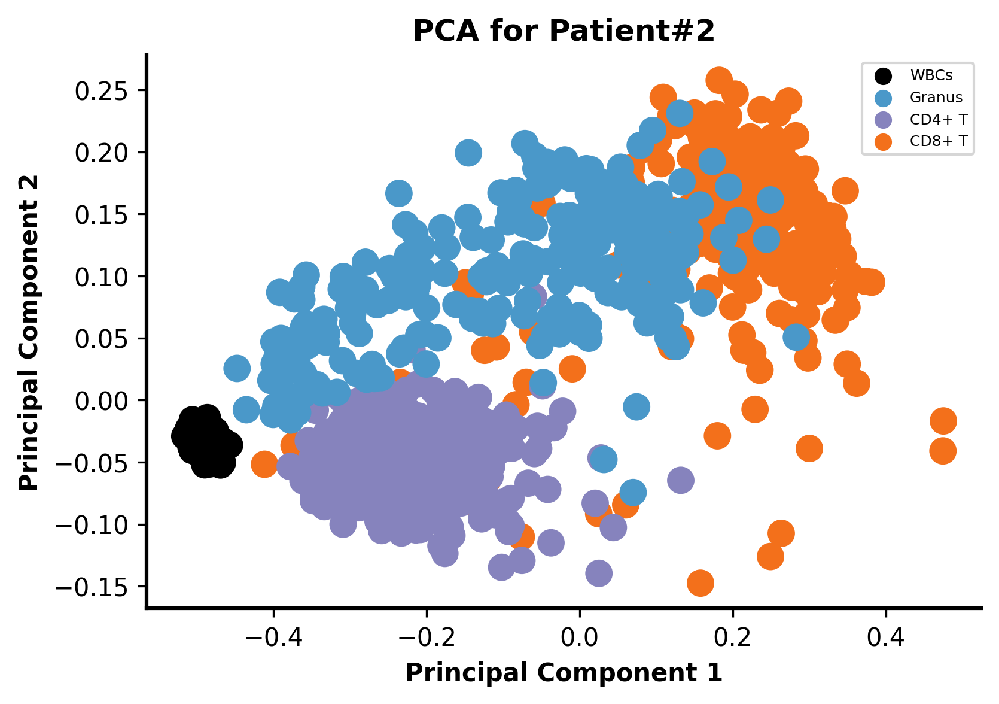

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6))
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/2143274147.py:15: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)


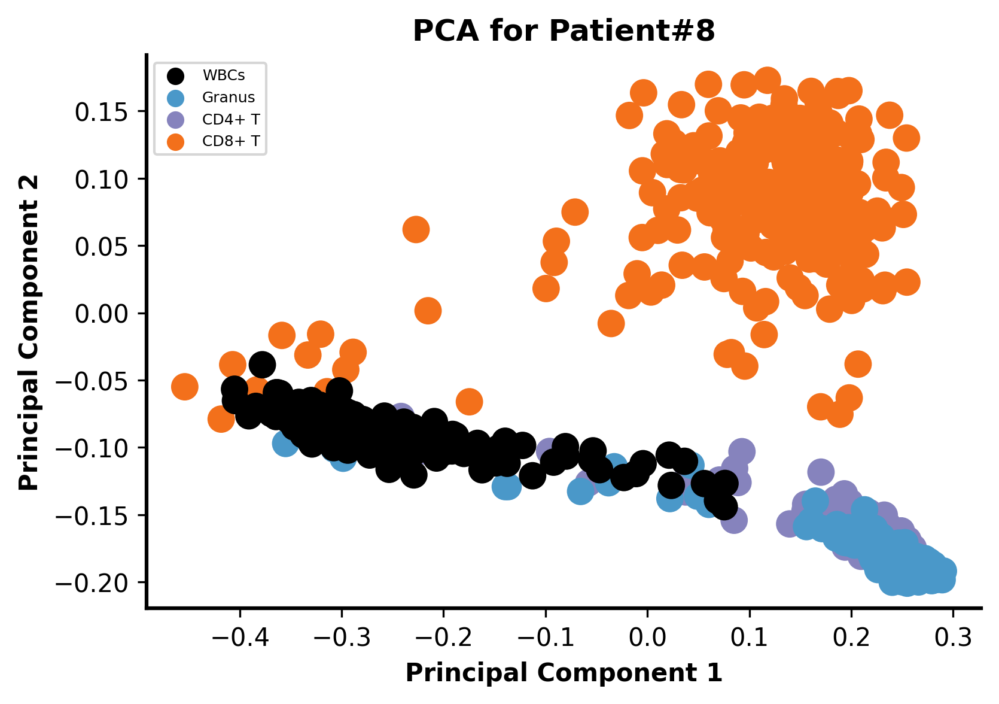

In [9]:
pca = PCA(n_components=0.95)
pca_result = pca.fit_transform(cell_check.iloc[:, 3:-1])  
print(f"Number of components explaining 95% variance: {pca.n_components_}")
df_pca = cell_check.copy()
df_pca['PCA1'] = pca_result[:, 0]
df_pca['PCA2'] = pca_result[:, 1]
d1 = df_pca['patient'].unique()
for patient in d1:
    patient_data = df_pca[df_pca['patient'] == patient]
    plt.figure(figsize=(6,4), dpi=300)
    patient_data['color'] = df_pca['cells'].map(lambda x: group_colors2[x](0.6)) 
    plt.scatter(patient_data['PCA1'], patient_data['PCA2'], c=patient_data['color'], s=100)
    for cell_value, cell_name in cell_mapping.items():
        plt.scatter([], [], c=group_colors2[cell_value](0.6), label=cell_name)
    plt.legend(fontsize=6)
    plt.title(f'PCA for {patient}',fontsize=12, fontweight='bold')
    plt.xlabel('Principal Component 1', fontsize=10, fontweight='bold')
    plt.ylabel('Principal Component 2', fontsize=10, fontweight='bold')
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['left'].set_linewidth(1.5)  
    plt.gca().spines['bottom'].set_linewidth(1.5) 
    plt.show()

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/3482059000.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('rainbow')
/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/3482059000.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['patient_index'] = group_data['patient'].map(lambda x: unique_patients.tolist().index(x) + 1)


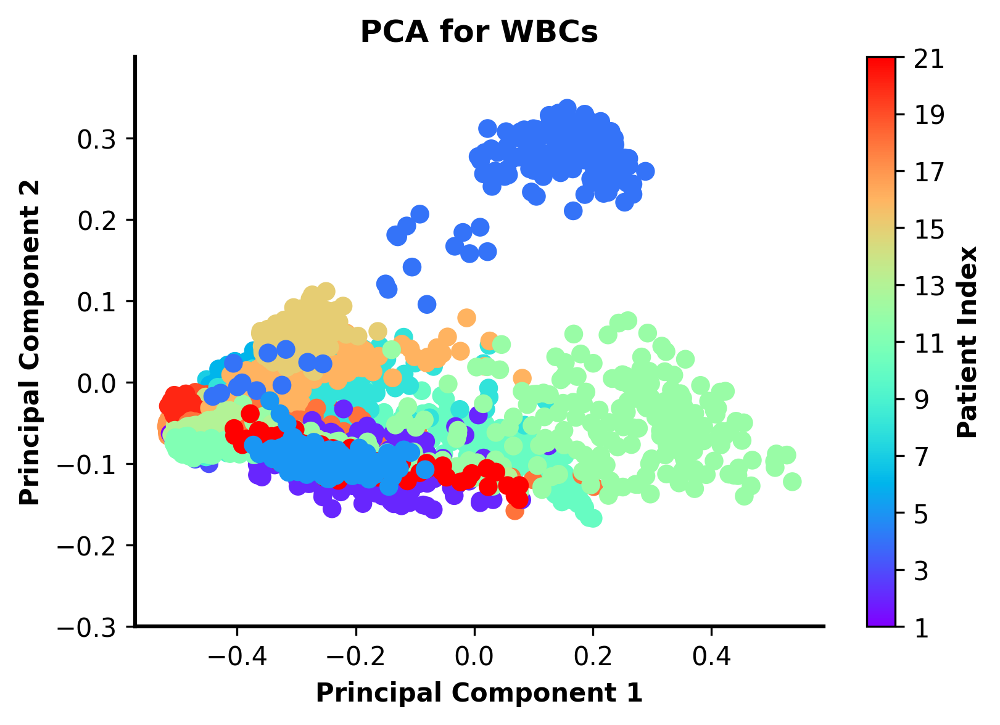

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/3482059000.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['patient_index'] = group_data['patient'].map(lambda x: unique_patients.tolist().index(x) + 1)


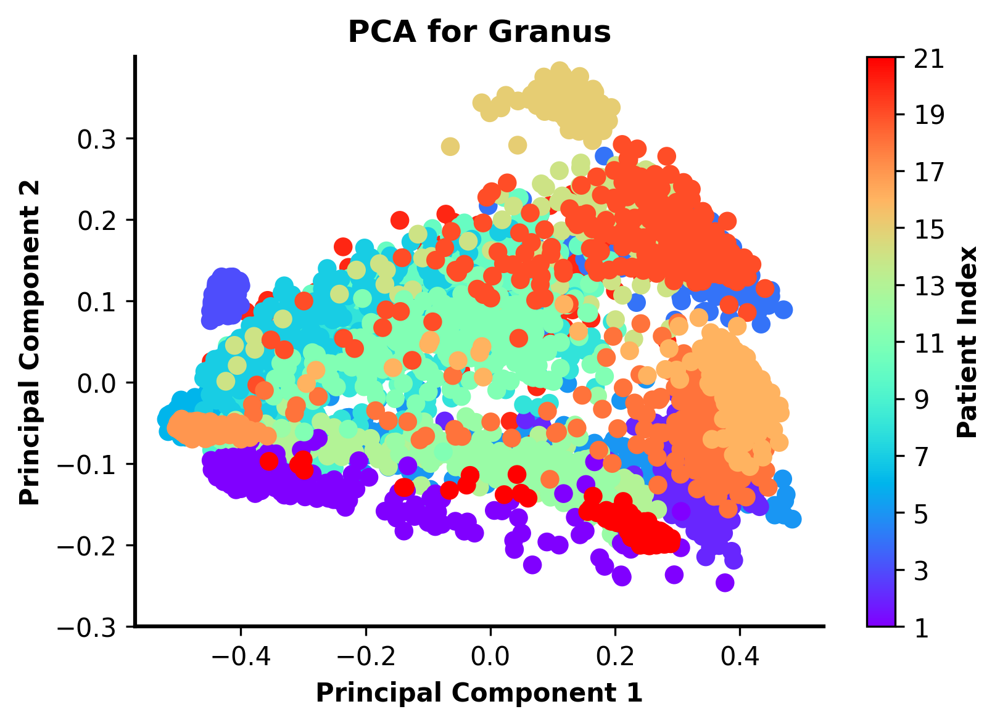

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/3482059000.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['patient_index'] = group_data['patient'].map(lambda x: unique_patients.tolist().index(x) + 1)


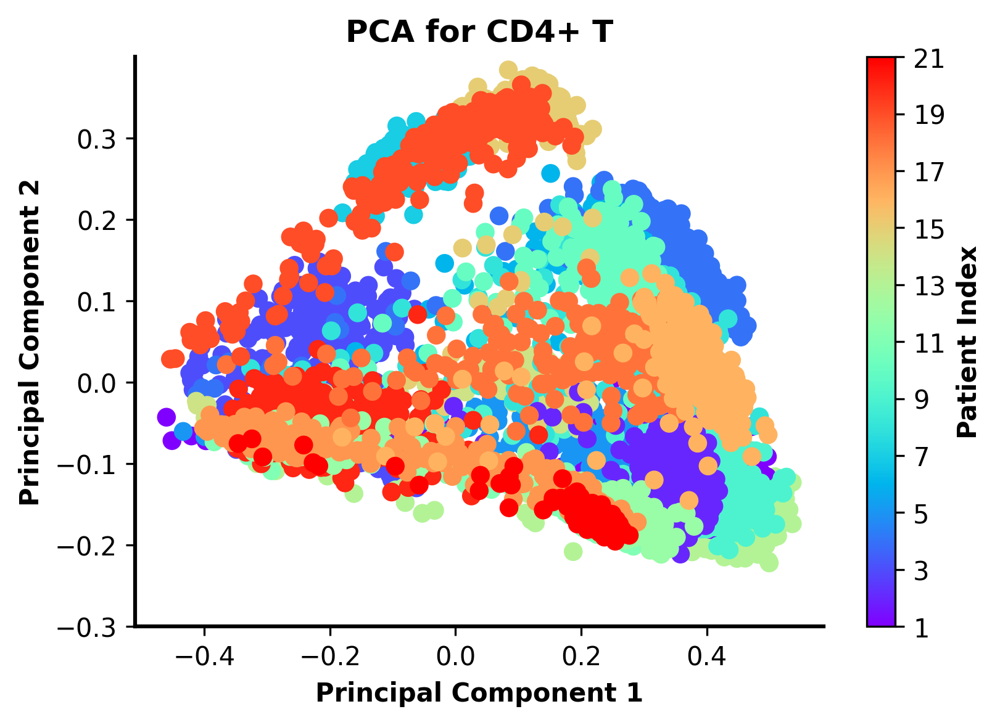

/var/folders/dz/3s8w7k7170xctsz47_h48gch0000gn/T/ipykernel_30605/3482059000.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['patient_index'] = group_data['patient'].map(lambda x: unique_patients.tolist().index(x) + 1)


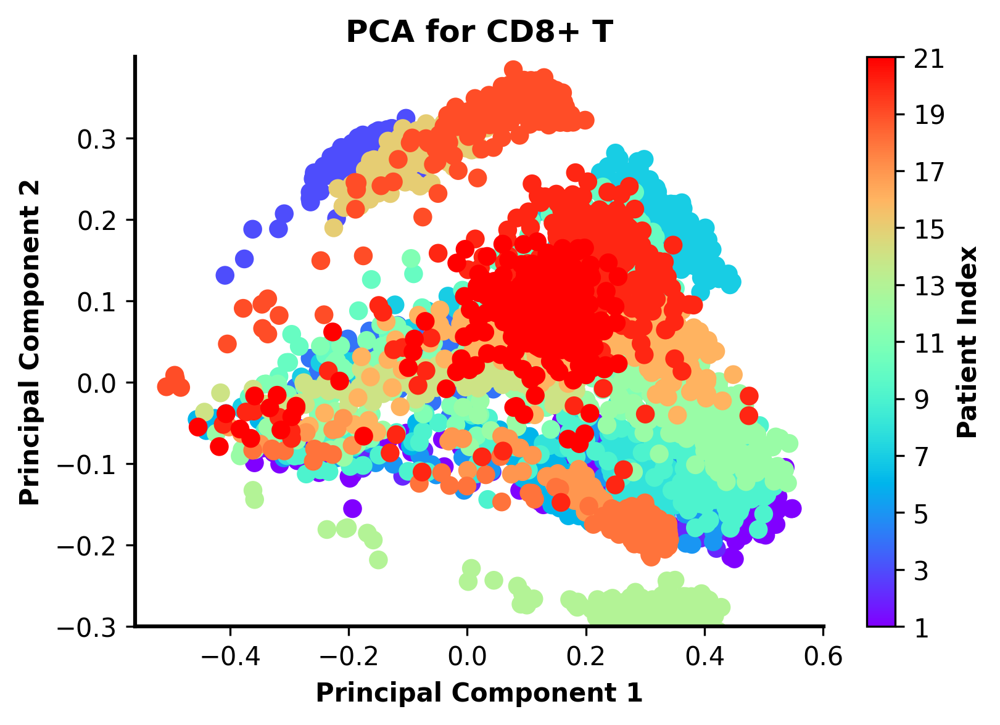

In [10]:
# Function to extract patient number from ID string, returns integer value
def extract_patient_number(patient_id):
    return int(re.search(r'#(\d+)', patient_id).group(1))  # Extract digits following 'patient#'
# Use the rainbow colormap to generate 60 distinct colors
cmap = plt.cm.get_cmap('rainbow')
# Get unique patient IDs and total sample count
unique_patients = df_pca['patient'].unique()
sample_count = len(unique_patients)  # Total number of patient samples
# Create a normalization object to map patient indices to the colormap
norm = plt.Normalize(vmin=1, vmax=sample_count)  # Assuming patient indices range from 1 to N

# Loop through each cell type and plot a 2D PCA scatter plot
for idx, (group, group_name) in enumerate(cell_mapping.items()):
    group_data = df_pca[df_pca['cells'] == group]  # Select data for the current cell type
    plt.figure(figsize=(6, 4), dpi=300)
    # Map patient IDs to indices (1-based) for coloring
    group_data['patient_index'] = group_data['patient'].map(lambda x: unique_patients.tolist().index(x) + 1)
    # Plot PCA scatter with patient-specific coloring
    scatter = plt.scatter(group_data['PCA1'], group_data['PCA2'], 
                          c=group_data['patient_index'].astype(int), 
                          cmap=cmap, norm=norm, s=40)
    # Add a colorbar representing patient index range
    cbar = plt.colorbar(scatter)
    cbar.set_ticks(range(1, sample_count + 1, 2))  # Show ticks every 2 steps
    cbar.set_label('Patient Index', fontsize=10, fontweight='bold')

    # Set titles and axis labels
    plt.title(f'PCA for {group_name}', fontsize=12, fontweight='bold')
    plt.xlabel('Principal Component 1', fontsize=10, fontweight='bold')
    plt.ylabel('Principal Component 2', fontsize=10, fontweight='bold')

    # Format y-axis range and ticks
    plt.ylim(-0.3, 0.4)
    plt.yticks(np.arange(-0.3, 0.4, 0.1))
    # Customize plot borders
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['left'].set_linewidth(1.5)
    plt.gca().spines['bottom'].set_linewidth(1.5)
    plt.show()

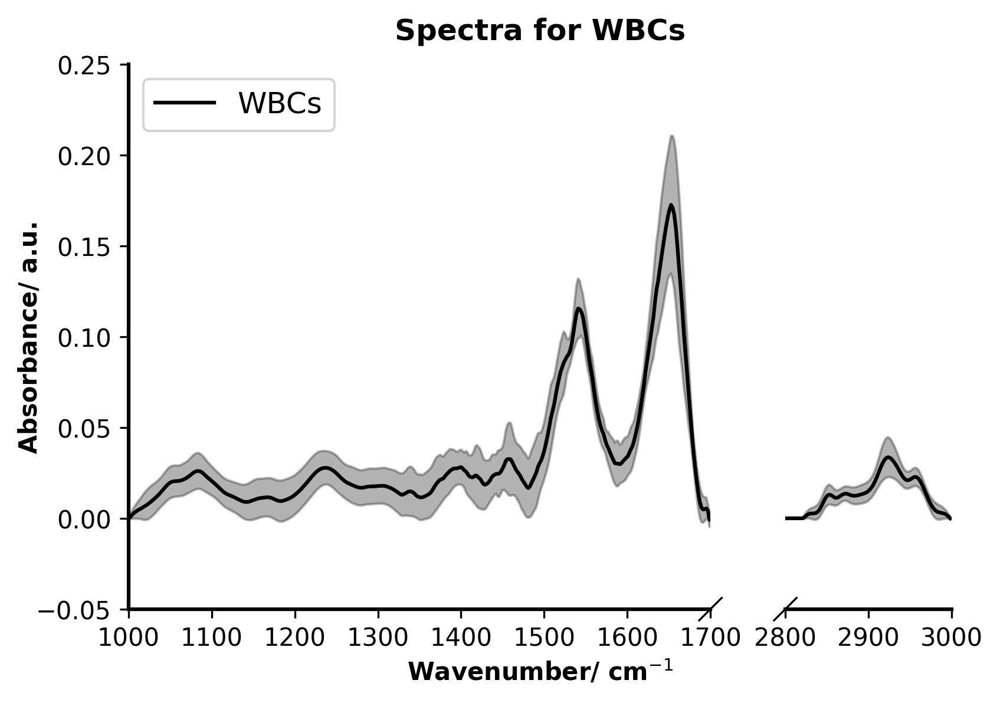

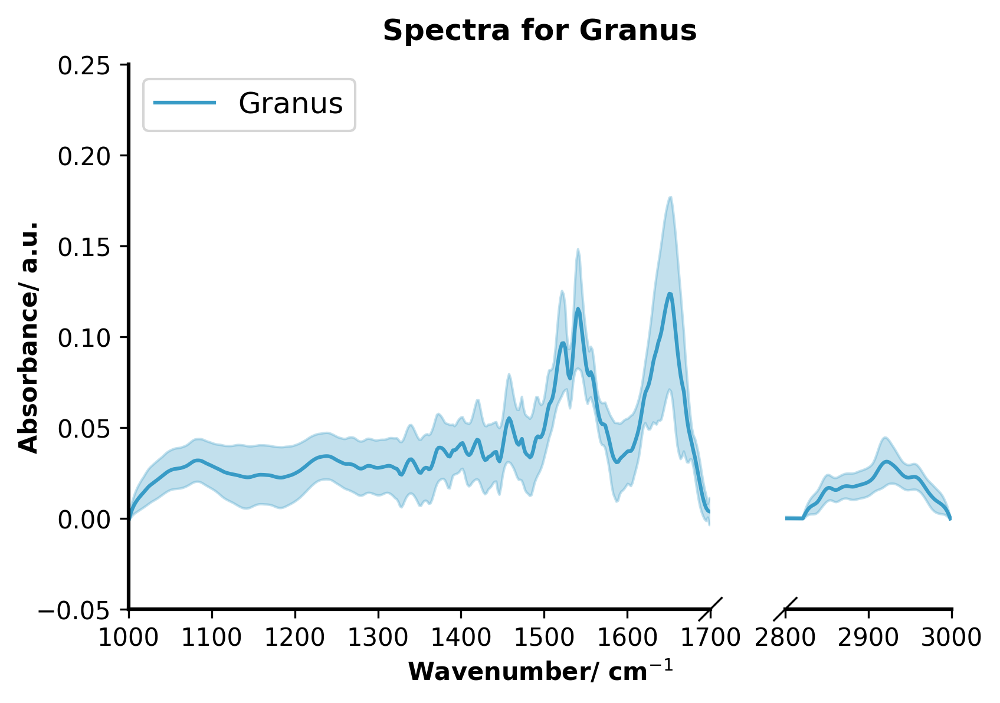

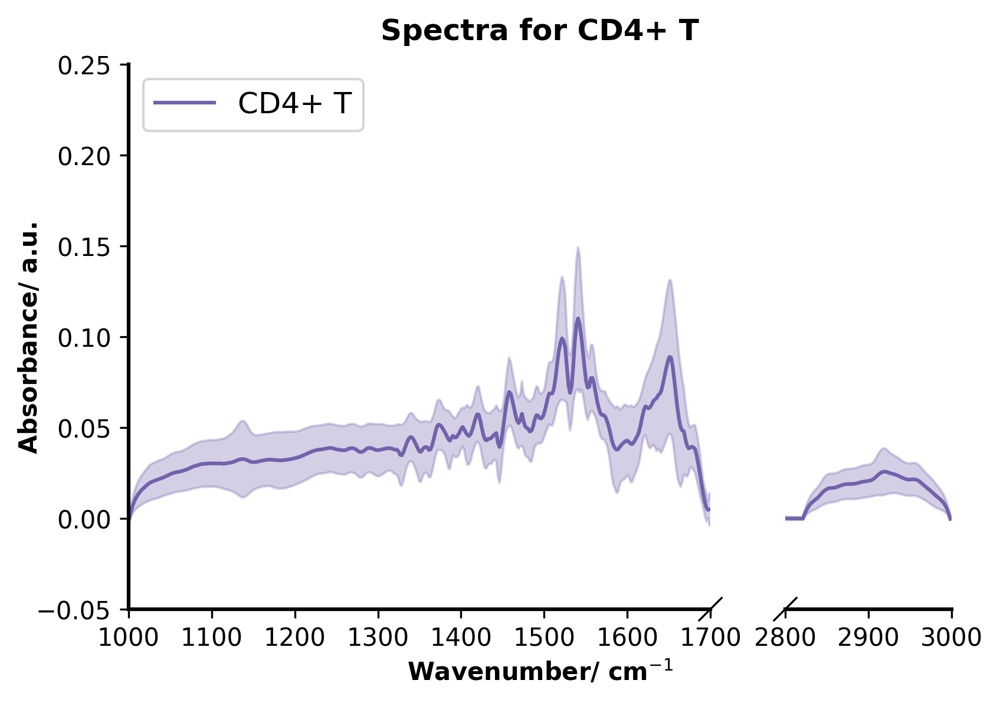

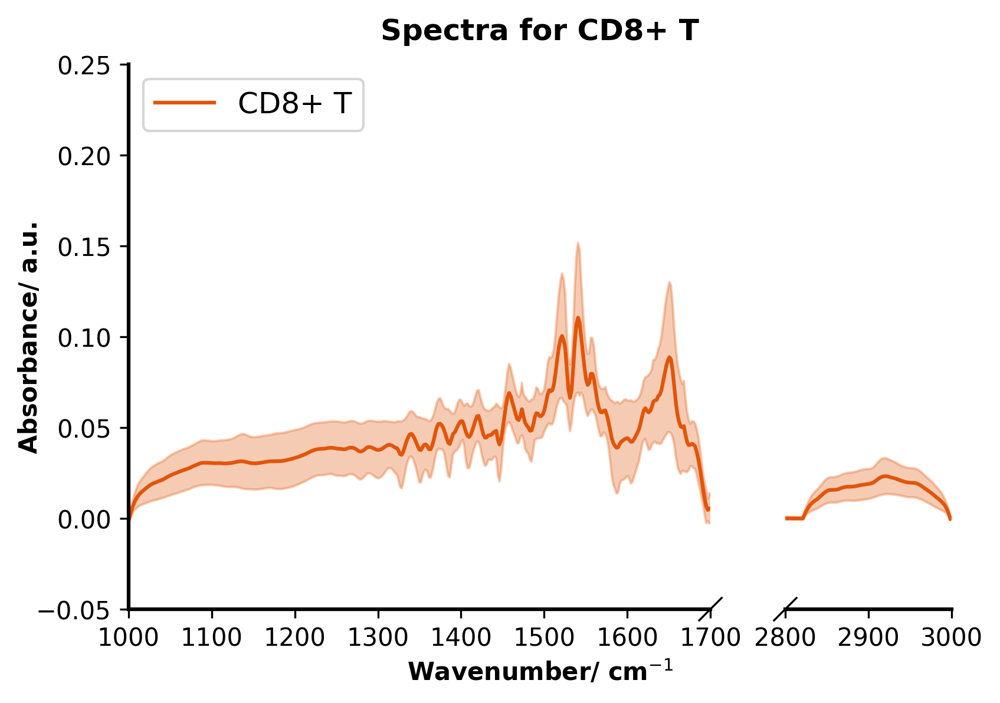

In [11]:
group_colors2 = {1: ListedColormap(['black']), 2:plt.cm.GnBu,  5:plt.cm.Purples, 6:plt.cm.Oranges}
plot_individual_spectra(combined_df_filter.iloc[:,:-1], cell_mapping, group_colors2, type_col='cells',figsize=(6,4), dpi=300)

In [12]:
from pca_visualization import plot_visualization2

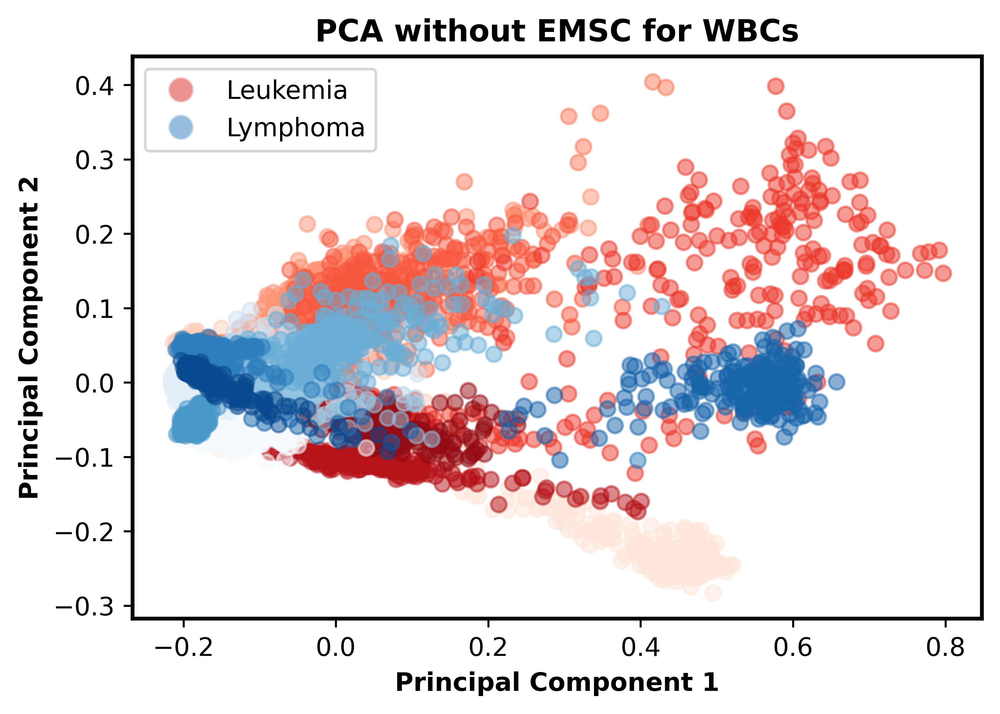

In [13]:
spectra1=spectra1[spectra1['group'].isin([1,2])]
group_colors = {1: plt.cm.Blues, 2: plt.cm.Reds,  }
pca = PCA(n_components=6)
spectra1_pca = pca.fit_transform(spectra1.iloc[:, 2:].values)
spectra2 = pd.concat([spectra1.reset_index(drop=True).iloc[:, :2], pd.DataFrame(spectra1_pca, columns=[f'PC{i+1}' for i in range(spectra1_pca.shape[1])])], axis=1)

groups_id =[2., 1.]
plot_visualization2([{'data': spectra2, 'label': 'Train', 'marker': 'o'},], 
                     groups_id, group_colors, label_mapping, 'PCA without EMSC for WBCs','Principal Component 1','Principal Component 2',visible_groups=[1,2])

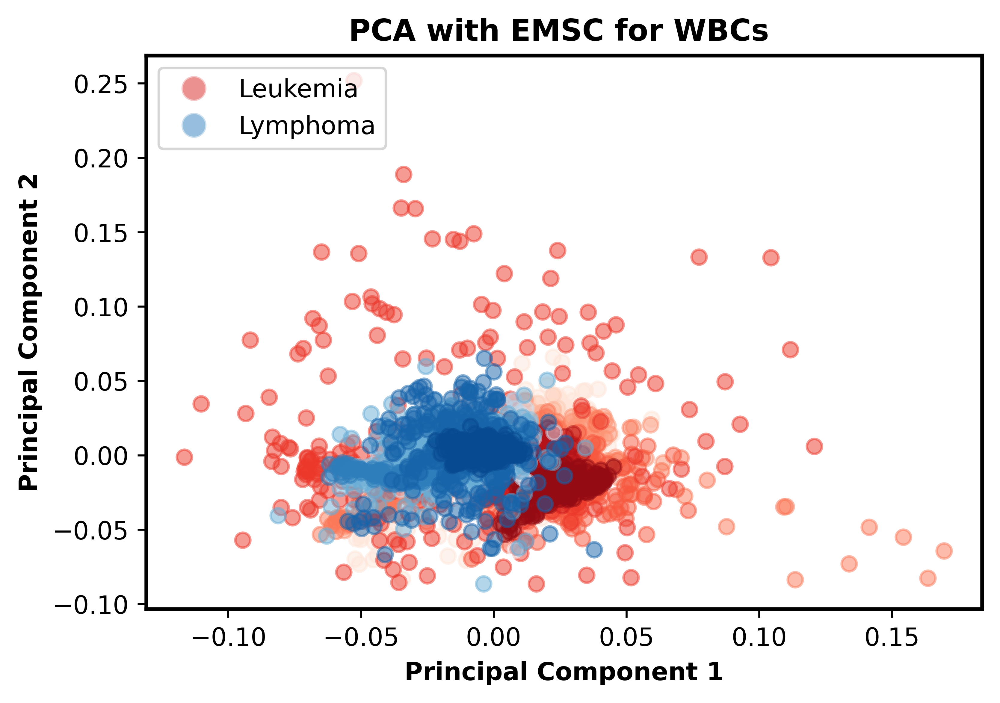

In [14]:
data=spectra1
n_components=20
loading=5
mean_values = data.iloc[:, 2:].mean()
emsc_corrected_data_list=[]
for group in groups_id:
    data_group = data[data['group'] == group]
    # Perform PCA before EMSC
    pca = PCA(n_components=n_components)
    pca_before_emsc = pca.fit_transform(data_group.iloc[:, 2:])
    spectra_data_group = data_group.iloc[:, 2:].astype(float)
    emsc_result = emsc(np.array(spectra_data_group), degree=0, reference=np.array(mean_values).astype(float), interferent=pca.components_[:loading].astype(float))
    emsc_corrected_group = data_group.copy()
    emsc_corrected_group.iloc[:, 2:] = emsc_result['corrected']
    emsc_corrected_data_list.append(emsc_corrected_group)

# Combine EMSC-corrected data
emsc_corrected_combined = pd.concat(emsc_corrected_data_list)
consensus_pca = PCA(n_components=n_components)

pca_consensus_transformed = consensus_pca.fit_transform(emsc_corrected_combined.iloc[:, 2:])

pca_consensus_df = pd.concat([emsc_corrected_combined.reset_index(drop=True).iloc[:, :2], pd.DataFrame(pca_consensus_transformed, columns=[f'PC{i+1}' for i in range(pca_consensus_transformed.shape[1])])], axis=1)

groups_id =pca_consensus_df['group'].unique()
plot_visualization2([{'data': pca_consensus_df, 'label': 'Train', 'marker': 'o'},                    ], 
                 groups_id, group_colors, label_mapping, 'PCA with EMSC for WBCs ','Principal Component 1','Principal Component 2',visible_groups=[1,2])


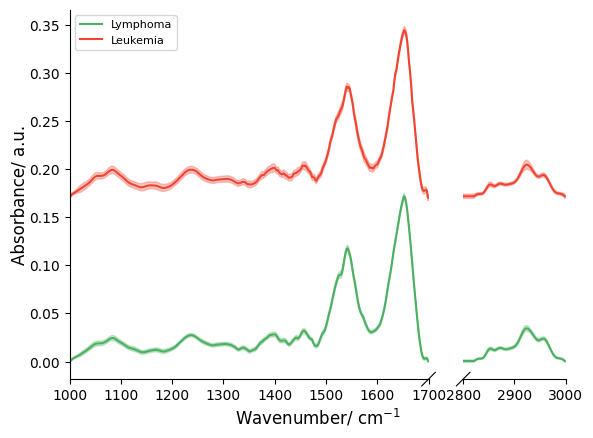

In [15]:
label_mapping = {1: 'Lymphoma', 2: 'Leukemia', }
group_colors = {2: plt.cm.Reds, 1: plt.cm.Greens, }
plot_stacked_spectra(emsc_corrected_combined, label_mapping, group_colors, n=1)

# classification

In [16]:
from fullmodel import run_fusion_experiments

In [ ]:
#### this is for the figure 5d
summary_5d, folds_5d = run_fusion_experiments(
    processed_data_dict,
    fusion_modes=['raw'],
    cv_type='groupkfold',
    pre_pca_components_list=[5, 7, 15, 20, 30, 40, 50],
    n_components_list=[5, 7, 15, 20, 30, 40, 50],
    n_splits=10,
    preprocessing='emsc',
    combination_sizes=[1]
)

In [ ]:
#### this is for the figure 5d
summary2_5d, folds2_5d = run_fusion_experiments(
    processed_data_dict,
    fusion_modes=['raw'],
    cv_type='groupkfold',
    pre_pca_components_list=[5, 7, 15, 20, 30, 40, 50],
    n_components_list=[5, 7, 15, 20, 30, 40, 50],
    n_splits=10,
    preprocessing=None,
    combination_sizes=[1]
)

In [ ]:
#### this is for the figure 5c
summary_5c, folds_5c = run_fusion_experiments(
    processed_data_dict,
    fusion_modes=['raw'],
    cv_type='kfold',
    pre_pca_components_list=[5, 7, 15, 20, 30, 40, 50],
    n_components_list=[5, 7, 15, 20, 30, 40, 50],
    n_splits=10,
    preprocessing=None,
    combination_sizes=[1]
)

In [ ]:
#### this is for the figure 6
summary6, folds6 = run_fusion_experiments(
    processed_data_dict,
    fusion_modes=['raw','pca','model'],
    cv_type='groupkfold',
    pre_pca_components_list=[5, 7, 15, 20, 30, 40, 50],
    n_components_list=[5, 7, 15, 20, 30, 40, 50],
    n_splits=10,
    preprocessing=None,
    combination_sizes=[1,2,3,4]
)

In [ ]:
#### this is for the figure 6
summary6_emsc, folds6_emsc = run_fusion_experiments(
    processed_data_dict,
    fusion_modes=['raw','pca','model'],
    cv_type='groupkfold',
    pre_pca_components_list=[5, 7, 15, 20, 30, 40, 50],
    n_components_list=[5, 7, 15, 20, 30, 40, 50],
    n_splits=10,
    preprocessing='emsc',
    combination_sizes=[1,2,3,4]
)

In [ ]:
## save results examples
desktop_path = os.path.join(os.path.expanduser('~'), 'Desktop')
output_file = os.path.join(desktop_path, 'summary_5d.pkl')
with open(output_file, 'wb') as f:
    pickle.dump(summary_5d, f)

print(f"save to the folder: {output_file}")

# drawing results

In [17]:
###Results, all results have been saved
data_path = '/Users/laying/Desktop/P1_cancer_differentiation/Results'
input_file3 = os.path.join(data_path, 'summary_5c.pkl')
with open(input_file3, 'rb') as f:
    summary_5c = pickle.load(f)

input_file4 = os.path.join(data_path, 'summary_5d.pkl')
with open(input_file4, 'rb') as f:
    summary_5d = pickle.load(f)

input_file5 = os.path.join(data_path, 'summary2_5d.pkl')
with open(input_file5, 'rb') as f:
    summary2_5d = pickle.load(f)

input_file6 = os.path.join(data_path, 'summary6.pkl')
with open(input_file6, 'rb') as f:
    summary6 = pickle.load(f)

input_file7 = os.path.join(data_path, 'summary6_emsc.pkl')
with open(input_file7, 'rb') as f:
    summary6_emsc = pickle.load(f)

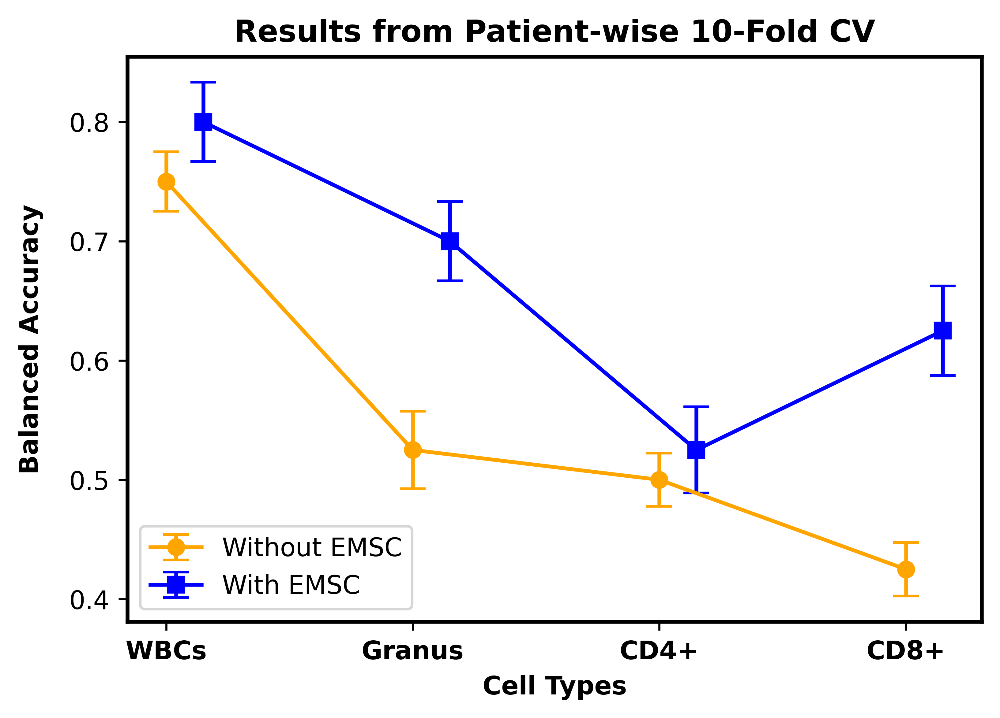

In [18]:
## Figure5d
assert summary_5d['combination'].tolist() == summary2_5d['combination'].tolist()
combs      = summary_5d['combination'].tolist()
means_yes  = summary_5d['mean_accuracy'].values
stds_yes   = summary_5d['std_accuracy'].values
means_no   = summary2_5d['mean_accuracy'].values
stds_no    = summary2_5d['std_accuracy'].values
x     = np.arange(len(combs))
offset = 0.15
palette = {'Without EMSC': 'orange', 'With EMSC': 'blue'}
# —— figure —— 
plt.figure(figsize=(6, 4), dpi=600)
# without EMSC
plt.errorbar(
    x , means_no, 
    yerr=0.1 * stds_no,           
    fmt='o-', capsize=5, 
    color=palette['Without EMSC'], 
    label='Without EMSC', 
    linewidth=1.5
)
# with EMSC
plt.errorbar(
    x + offset, means_yes, 
    yerr=0.1 * stds_yes,
    fmt='s-', capsize=5, 
    color=palette['With EMSC'], 
    label='With EMSC', 
    linewidth=1.5
)

plt.legend().set_visible(False)
plt.gca().spines['left'].set_linewidth(1.5)   
plt.gca().spines['bottom'].set_linewidth(1.5) 
plt.gca().spines['right'].set_linewidth(1.5)   
plt.gca().spines['top'].set_linewidth(1.5) 
plt.xticks(x, combs, rotation=0, ha='center', fontweight='bold')
plt.xlabel('Cell Types', fontsize=10, fontweight='bold')
plt.ylabel('Balanced Accuracy', fontsize=10, fontweight='bold',labelpad=10)
plt.title('Results from Patient-wise 10-Fold CV', fontsize=12, fontweight='bold')
plt.legend(fontsize=10,loc='lower left')
plt.show()

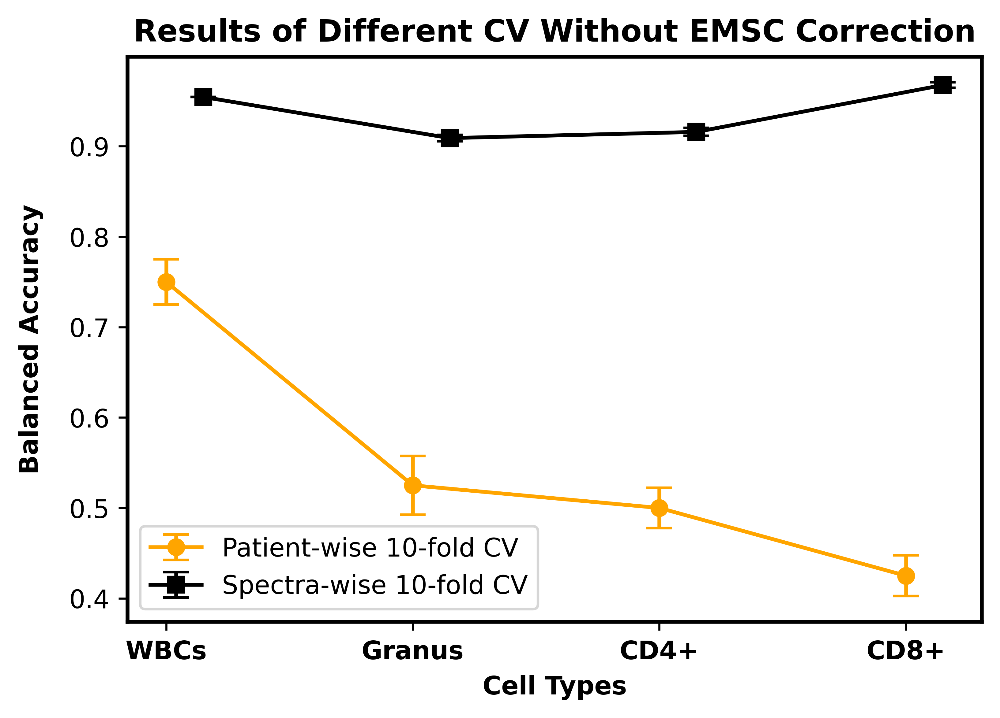

In [19]:
## Figure5c
assert summary_5c['combination'].tolist() == summary2_5d['combination'].tolist()
combs      = summary_5c['combination'].tolist()
means_yes  = summary_5c['mean_accuracy'].values
stds_yes   = summary_5c['std_accuracy'].values
means_no   = summary2_5d['mean_accuracy'].values
stds_no    = summary2_5d['std_accuracy'].values

x     = np.arange(len(combs))
offset = 0.15
palette = {'Patient-wise 10-fold CV': 'orange', 'Spectra-wise 10-fold CV': 'Black'}


plt.figure(figsize=(6, 4), dpi=600)
plt.errorbar(
    x , means_no, 
    yerr=0.1 * stds_no,           
    fmt='o-', capsize=5, 
    color=palette['Patient-wise 10-fold CV'], 
    label='Patient-wise 10-fold CV', 
    linewidth=1.5
)
plt.errorbar(
    x + offset, means_yes, 
    yerr=0.1 * stds_yes,
    fmt='s-', capsize=5, 
    color=palette['Spectra-wise 10-fold CV'], 
    label='Spectra-wise 10-fold CV', 
    linewidth=1.5
)

plt.legend().set_visible(False)
plt.gca().spines['left'].set_linewidth(1.5)   
plt.gca().spines['bottom'].set_linewidth(1.5) 
plt.gca().spines['right'].set_linewidth(1.5)   
plt.gca().spines['top'].set_linewidth(1.5) 

plt.xticks(x, combs, rotation=0, ha='center', fontweight='bold')
plt.xlabel('Cell Types', fontsize=10, fontweight='bold')
plt.ylabel('Balanced Accuracy', fontsize=10, fontweight='bold',labelpad=10)
plt.title('Results of Different CV Without EMSC Correction', fontsize=12, fontweight='bold')
plt.legend(fontsize=10,loc='lower left')
plt.show()

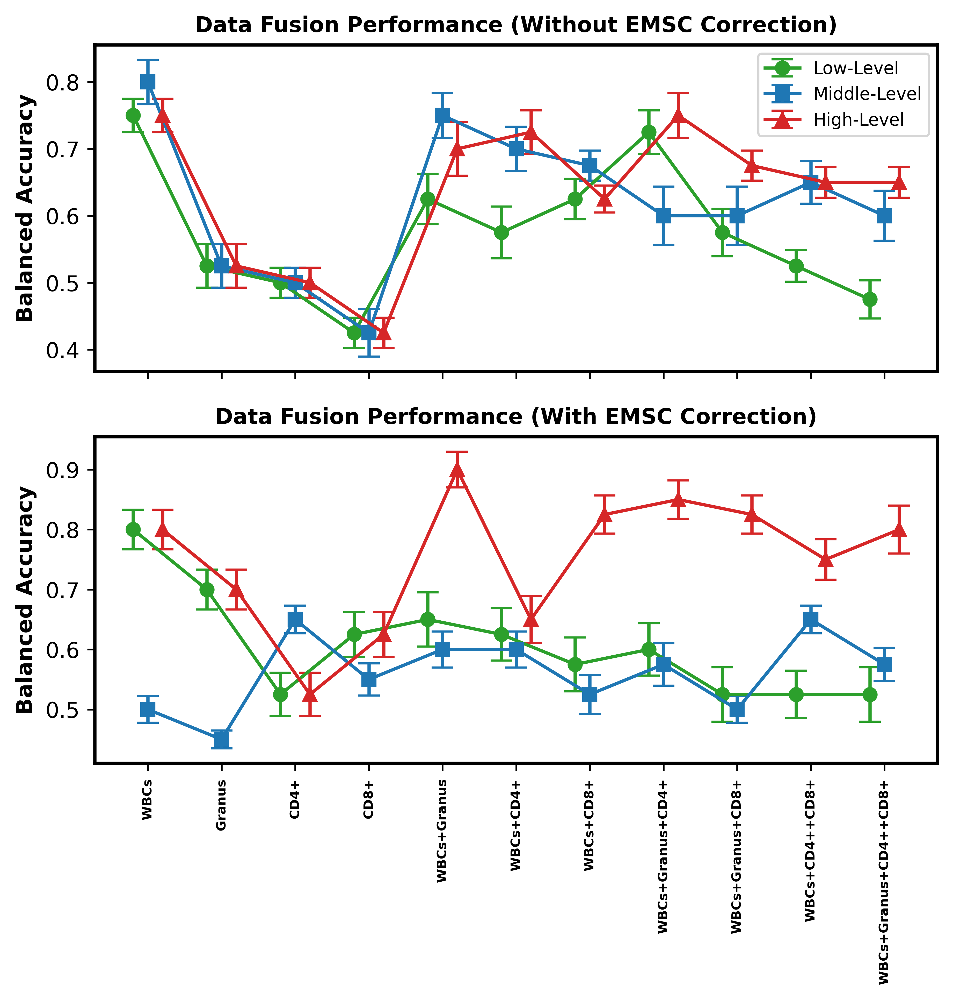

In [20]:
def keep_wbc_or_single(df):
    """Keep rows where only one cell type is used or 'WBCs' is part of the combination."""
    return df[df['keys'].apply(lambda tup: len(tup) == 1 or 'WBCs' in tup)]

# Define fusion types
fusion_types = ['raw', 'pca', 'model']

# Organize datasets for EMSC correction and no correction
datasets = {
    'no': summary6,
    'yes': summary6_emsc
}

# Filter data: keep single-cell-type and WBCs-involved fusions only
filtered = {
    emsc: {
        ftype: keep_wbc_or_single(df[df['fusion'] == ftype])
        for ftype in fusion_types
    }
    for emsc, df in datasets.items()
}

# Ensure matching combinations between EMSC yes/no datasets
for ftype in fusion_types:
    assert filtered['no'][ftype]['combination'].tolist() == filtered['yes'][ftype]['combination'].tolist()

# Preserve original order from 'raw' fusion type, only keeping combinations present in all fusion levels
base_order = filtered['no']['raw']['combination'].tolist()
target_order = [
    comb for comb in base_order
    if all(comb in filtered['no'][ft]['combination'].tolist() for ft in fusion_types)
]

# Reindex data to match preserved order
for emsc in ['no', 'yes']:
    for ftype in fusion_types:
        filtered[emsc][ftype] = (
            filtered[emsc][ftype]
            .set_index('combination')
            .loc[target_order]
            .reset_index()
        )

# X-axis positions
x = np.arange(len(target_order))
offset = 0.2

# Define plotting styles for each fusion level
level_info = {
    'Low-Level':    {'ftype': 'raw',   'marker': 'o', 'color': 'tab:green'},
    'Middle-Level': {'ftype': 'pca',   'marker': 's', 'color': 'tab:blue'},
    'High-Level':   {'ftype': 'model', 'marker': '^', 'color': 'tab:red'}
}

# Create figure with two subplots (upper: no EMSC, lower: with EMSC)
fig, (ax_top, ax_bottom) = plt.subplots(2, 1, figsize=(7, 6), sharex=True, dpi=600)

# Correct subplot mapping: top → no EMSC, bottom → with EMSC
for ax, emsc_tag in zip((ax_top, ax_bottom), ['no', 'yes']):
    title = 'Without EMSC Correction' if emsc_tag == 'no' else 'With EMSC Correction'
    for i, (level, info) in enumerate(level_info.items()):
        df = filtered[emsc_tag][info['ftype']]
        means = df['mean_accuracy'].values
        stds = df['std_accuracy'].values

        ax.errorbar(
            x + (i - 1) * offset,
            means,
            yerr=0.1 * stds,
            fmt=f"{info['marker']}-",
            capsize=5,
            color=info['color'],
            linewidth=1.5,
            label=level
        )

    ax.set_title(f'Data Fusion Performance ({title})', fontsize=10, fontweight='bold')
    ax.set_ylabel('Balanced Accuracy', fontsize=10, fontweight='bold')
    ax.spines['left'].set_linewidth(1.5)
    ax.spines['bottom'].set_linewidth(1.5)
    ax.spines['top'].set_linewidth(1.5)
    ax.spines['right'].set_linewidth(1.5)
    ax.grid(False)

# Set consistent x-axis labels
ax_bottom.set_xticks(x)
ax_bottom.set_xticklabels(target_order, rotation=90, ha='center', fontsize=6, fontweight='bold')

# Add legend
ax_top.legend(fontsize=8)
plt.show()
